### Script for comparing different ocr-workflows
#### Goal: comparable value to evaluate the benefits of different text recognition approaches


**Step 1:** Read in data sets -gt.txt and -out.txt

**Step 2:** Fill dict according to lines

**Step 3:** Check output-lines for the similarity to groundtruth-lines (using SequenceMatcher)

**Step 4:** Perform for all text files within certain folder 

**Step 5:** Check the total percentage of similarity for each workflow

### Workflow: TIF
**Before:** Using the best language and font models from Tesseract on .tif files to generate text output

In [1]:
# import OS module to use operating system dependent functionalities
import os
os.path

<module 'ntpath' from 'C:\\Users\\merle\\AppData\\Local\\Programs\\Python\\Python310\\lib\\ntpath.py'>

In [2]:
# create list of all files in ./Stichprobe_TIFF
file_list = os.listdir("./Stichprobe_TIFF")
# create separated list for -gt.txt and -out.txt files
file_list_gt=[]
file_list_out=[]
for file in file_list:
    if file.endswith("-gt.txt"):
        file_list_gt.append(file)
    if file.endswith("-out.txt"):
        file_list_out.append(file)

In [3]:
# check output files list
file_list_out

['KaUf_73_1_0002.tif-sat0.tif-out.txt',
 'KaUf_73_1_0003.tif-sat0.tif-out.txt',
 'KaUf_73_1_0004.tif-sat0.tif-out.txt',
 'KaUf_73_1_0005.tif-sat0.tif-out.txt',
 'KaUf_74_1_0019.tif-sat0.tif-out.txt',
 'KaUf_74_1_0020.tif-sat0.tif-out.txt',
 'KaUf_74_1_0021.tif-sat0.tif-out.txt',
 'KaUf_74_1_0022.tif-sat0.tif-out.txt',
 'KaUf_74_2_0004.tif-sat0.tif-out.txt',
 'KaUf_74_2_0005.tif-sat0.tif-out.txt',
 'KaUf_74_2_0006.tif-sat0.tif-out.txt',
 'KaUf_74_2_0007.tif-sat0.tif-out.txt',
 'KaUf_75_1_0004.tif-sat0.tif-out.txt',
 'KaUf_75_1_0006.tif-sat0.tif-out.txt',
 'KaUf_75_1_0008.tif-sat0.tif-out.txt',
 'KaUf_75_1_0010.tif-sat0.tif-out.txt',
 'KaUf_76_1_0004.tif-sat0.tif-out.txt',
 'KaUf_76_1_0005.tif-sat0.tif-out.txt',
 'KaUf_76_1_0006.tif-sat0.tif-out.txt',
 'KaUf_76_1_0008.tif-sat0.tif-out.txt',
 'KaUf_76_2_0052.tif-sat0.tif-out.txt',
 'KaUf_76_2_0053.tif-sat0.tif-out.txt',
 'KaUf_76_2_0054.tif-sat0.tif-out.txt',
 'KaUf_76_2_0055.tif-sat0.tif-out.txt',
 'KaUf_77_1_0002.tif-sat0.tif-out.txt',


In [4]:
# check ground truth files list
file_list_gt

['KaUf_73_1_0002-gt.txt',
 'KaUf_73_1_0003-gt.txt',
 'KaUf_73_1_0004-gt.txt',
 'KaUf_73_1_0005-gt.txt',
 'KaUf_74_1_0019-gt.txt',
 'KaUf_74_1_0020-gt.txt',
 'KaUf_74_1_0021-gt.txt',
 'KaUf_74_1_0022-gt.txt',
 'KaUf_74_2_0004-gt.txt',
 'KaUf_74_2_0005-gt.txt',
 'KaUf_74_2_0006-gt.txt',
 'KaUf_74_2_0007-gt.txt',
 'KaUf_75_1_0004-gt.txt',
 'KaUf_75_1_0006-gt.txt',
 'KaUf_75_1_0008-gt.txt',
 'KaUf_75_1_0010-gt.txt',
 'KaUf_76_1_0004-gt.txt',
 'KaUf_76_1_0005-gt.txt',
 'KaUf_76_1_0006-gt.txt',
 'KaUf_76_1_0008-gt.txt',
 'KaUf_76_2_0052-gt.txt',
 'KaUf_76_2_0053-gt.txt',
 'KaUf_76_2_0054-gt.txt',
 'KaUf_76_2_0055-gt.txt',
 'KaUf_77_1_0002-gt.txt',
 'KaUf_77_1_0003-gt.txt',
 'KaUf_77_1_0004-gt.txt',
 'KaUf_77_1_0005-gt.txt',
 'KaUf_77_2_0004-gt.txt',
 'KaUf_77_2_0006-gt.txt',
 'KaUf_77_2_0007-gt.txt',
 'KaUf_77_2_0008-gt.txt',
 'KaUf_78_1_0004-gt.txt',
 'KaUf_78_1_0005-gt.txt',
 'KaUf_78_1_0006-gt.txt',
 'KaUf_78_1_0007-gt.txt',
 'KaUf_79_1_0003-gt.txt',
 'KaUf_79_1_0004-gt.txt',
 'KaUf_79_1_

In [5]:
# prepare dict with filename as key and lines as values (ground truth)
file_dict_gt= {}
for file_name in file_list_gt:
    file_dict_gt[file_name] = []

# for each file in list oft gt.txt files
for file_name in file_list_gt:    
    # open file
    file = open(f'./Stichprobe_TIFF/{file_name}',"r",encoding='utf-8')
    # for each line in opened file
    for line in file:
        # remove \n
        line = line.strip("\n")
        if len(line) != 0:
            # add line to value of dict key of that file
            file_dict_gt[file_name].append(line)
    file.close()

print(file_dict_gt)

{'KaUf_73_1_0002-gt.txt': ['HAUPTSACHE FERIEN', 'Musik: Heinz Kiessling', 'Regie: Peter Weck', 'Darsteller: Peter Alexander, Christiane', 'Hörbiger, Theo Lingen, Martin Held', 'u. v. a.', 'Art: LUSTSPIEL', '418-1 ca. 120 m - S 8 - Color - Tonfilm', '418-3 ca. 120 m - S 8 - S/W - Tonfilm', 'Lehrer und Schüler haben am letzten Schultag', 'nur einen Gedanken: Hauptsache Ferien! Für', 'Studienrat Dr. Peter Markus und seine Toch-', 'ter Gaby bedeuten sie Sommer, Sonne, Cam-', 'ping! Für Corinna, Gabys Klassenkameradin, ', 'allerdings bringt der letzte Schultag nur die', 'Gewißheit: Sitzengeblieben! Corinna sieht al-', 'lerdings noch eine Möglichkeit: ihr reicher', 'Papa muß mit Geld den Weg zum Abitur', 'pflastern. Er soll Dr. Markus bestechen. Dieser', 'aber lehnt die Versetzung ab. Darum greift ihr', 'Vater zu einem letzte Mittel.', 'Ufa-Exclusiv-Serie', 'Hauptsache Ferien', 'Best.-Nr. 418, 419, 420 compl.', '= ca. 360 Meter - 60 Min.', 'PETER DER GROSSE', 'Musik: Heinz Kiessling', 'Regie

In [6]:
# prepare dict with filename as key and lines as values (output)
file_dict_out= {}
for file_name in file_list_out:
    file_dict_out[file_name] = []

# for each file in list oft text.txt files
for file_name in file_list_out:    
    # open file
    file = open(f'./Stichprobe_TIFF/{file_name}',"r",encoding='utf-8') # FILLOUT
    # for each line in file
    for line in file:
        # remove \n
        line = line.strip("\n")
        if len(line) != 0:
            # add line to value of dict key of that file
            file_dict_out[file_name].append(line)
    file.close()

print(file_dict_out)

{'KaUf_73_1_0002.tif-sat0.tif-out.txt': ['Titel', 'Inhaltsangabe', 'UFA-ATB-Super 8-Tonfilme in deutscher Sprache', 'HAUPTSACHE FERIEN', 'Musik: Heinz Kiessling', 'Regie: Peter Weck', 'Darsteller: Peter Alexander, Christiane', 'Hörbiger, Theo Lingen, Martin Held', 'uU. V. a..', 'Art: LUSTSPIEL', 'ca. 120 m - S 8 - Color - Tonfilm', 'Lehrer und Schüler haben am letzten Schultag', 'nur einen Gedanken: Hauptsache Ferien! Für', 'Studienrat Dr. Peter Markus und seine Toch-', 'ter Gaby bedeuten sie Sommer, Sonne, Cam-', 'ping! Für Corinna, Gabys Klassenkameradin,', 'allerdings bringt der letzte Schultag nur die', 'Gewißheit: Sitzengeblieben! Corinna sieht al-', 'lerdings noch eine Möglichkeit: ihr reicher', 'Papa muß mit Geld den Weg zum Abitur', 'pflastern. Er soll Dr. Markus bestechen. Dieser', 'aber lehnt die Versetzung ab. Darum greift ihr', 'Vater zu einem letzten Mittel.', 'Ufa-Exclusiv-Serie', '„Hauptsache Ferien“', 'Peter Alexander', 'Thea Lingen', 'Martin Held', 'Christiane Hörbiger

In [7]:
# create result dict
result_dict = {}
for file_name in file_list_gt:
    result_dict[file_name.replace("-gt.txt", "")] = []
# check finished dict
result_dict

{'KaUf_73_1_0002': [],
 'KaUf_73_1_0003': [],
 'KaUf_73_1_0004': [],
 'KaUf_73_1_0005': [],
 'KaUf_74_1_0019': [],
 'KaUf_74_1_0020': [],
 'KaUf_74_1_0021': [],
 'KaUf_74_1_0022': [],
 'KaUf_74_2_0004': [],
 'KaUf_74_2_0005': [],
 'KaUf_74_2_0006': [],
 'KaUf_74_2_0007': [],
 'KaUf_75_1_0004': [],
 'KaUf_75_1_0006': [],
 'KaUf_75_1_0008': [],
 'KaUf_75_1_0010': [],
 'KaUf_76_1_0004': [],
 'KaUf_76_1_0005': [],
 'KaUf_76_1_0006': [],
 'KaUf_76_1_0008': [],
 'KaUf_76_2_0052': [],
 'KaUf_76_2_0053': [],
 'KaUf_76_2_0054': [],
 'KaUf_76_2_0055': [],
 'KaUf_77_1_0002': [],
 'KaUf_77_1_0003': [],
 'KaUf_77_1_0004': [],
 'KaUf_77_1_0005': [],
 'KaUf_77_2_0004': [],
 'KaUf_77_2_0006': [],
 'KaUf_77_2_0007': [],
 'KaUf_77_2_0008': [],
 'KaUf_78_1_0004': [],
 'KaUf_78_1_0005': [],
 'KaUf_78_1_0006': [],
 'KaUf_78_1_0007': [],
 'KaUf_79_1_0003': [],
 'KaUf_79_1_0004': [],
 'KaUf_79_1_0005': [],
 'KaUf_79_1_0006': [],
 'KaUf_79_2_0023': [],
 'KaUf_79_2_0024': [],
 'KaUf_79_2_0025': [],
 'KaUf_79_2

In [8]:
# SequenceMatcher: compare similarity of two strings by their ratio
from difflib import SequenceMatcher as SM

# iterate over keys in out.txt dict
for key in file_dict_gt:
    gt_value = file_dict_gt[key]
    # get beginning of file name and use it to extract value of out.txt dict
    out_value = file_dict_out[key.replace("-gt", ".tif-sat0.tif-out")]
    # for each pair of value compute distance measure 
    for string_gt in gt_value:
        print("*********************************************************")
        print("This is gt value:")
        print(string_gt)     
        best_ratio = 0
        for string_out in out_value:
            print("--------------------------------")
            print("Try fitting with this out value:")
            print(string_out)
            similarity_ratio = SM(None, string_gt, string_out).ratio()
            print(f'The score is: {similarity_ratio}')
            if similarity_ratio >= best_ratio:
                best_ratio = similarity_ratio
                best_string_out = string_out
        result_dict[key.replace("-gt.txt", "")].append({
            'groundtruth_line':string_gt,
            'output_line': best_string_out,
            'similarity_ratio': best_ratio })
        #if best_string_out in out_value:
            #out_value.remove(best_string_out)

*********************************************************
This is gt value:
HAUPTSACHE FERIEN
--------------------------------
Try fitting with this out value:
Titel
The score is: 0.09090909090909091
--------------------------------
Try fitting with this out value:
Inhaltsangabe
The score is: 0.06666666666666667
--------------------------------
Try fitting with this out value:
UFA-ATB-Super 8-Tonfilme in deutscher Sprache
The score is: 0.12903225806451613
--------------------------------
Try fitting with this out value:
HAUPTSACHE FERIEN
The score is: 1.0
--------------------------------
Try fitting with this out value:
Musik: Heinz Kiessling
The score is: 0.10256410256410256
--------------------------------
Try fitting with this out value:
Regie: Peter Weck
The score is: 0.11764705882352941
--------------------------------
Try fitting with this out value:
Darsteller: Peter Alexander, Christiane
The score is: 0.07142857142857142
--------------------------------
Try fitting with this ou

--------------------------------
Try fitting with this out value:
= ca. 240 Meter — 40 Min.
The score is: 0.058823529411764705
*********************************************************
This is gt value:
allerdings bringt der letzte Schultag nur die
--------------------------------
Try fitting with this out value:
Titel
The score is: 0.16
--------------------------------
Try fitting with this out value:
Inhaltsangabe
The score is: 0.20689655172413793
--------------------------------
Try fitting with this out value:
UFA-ATB-Super 8-Tonfilme in deutscher Sprache
The score is: 0.28888888888888886
--------------------------------
Try fitting with this out value:
HAUPTSACHE FERIEN
The score is: 0.03225806451612903
--------------------------------
Try fitting with this out value:
Musik: Heinz Kiessling
The score is: 0.11940298507462686
--------------------------------
Try fitting with this out value:
Regie: Peter Weck
The score is: 0.2903225806451613
--------------------------------
Try fitti

The score is: 0.11538461538461539
--------------------------------
Try fitting with this out value:
UFA-ATB-Super 8-Tonfilme in deutscher Sprache
The score is: 0.30952380952380953
--------------------------------
Try fitting with this out value:
HAUPTSACHE FERIEN
The score is: 0.03571428571428571
--------------------------------
Try fitting with this out value:
Musik: Heinz Kiessling
The score is: 0.13114754098360656
--------------------------------
Try fitting with this out value:
Regie: Peter Weck
The score is: 0.10714285714285714
--------------------------------
Try fitting with this out value:
Darsteller: Peter Alexander, Christiane
The score is: 0.15384615384615385
--------------------------------
Try fitting with this out value:
Hörbiger, Theo Lingen, Martin Held
The score is: 0.1917808219178082
--------------------------------
Try fitting with this out value:
uU. V. a..
The score is: 0.12244897959183673
--------------------------------
Try fitting with this out value:
Art: LUSTS

Musik: Heinz Kiessling Peter Markus von einem Fertighaus-Gewinn.
The score is: 0.35514018691588783
--------------------------------
Try fitting with this out value:
Regie: Peter Weck Zusammen mit den aus allen deutschen Lan-
The score is: 0.3333333333333333
--------------------------------
Try fitting with this out value:
ß as den stammenden Camping-Freunden bauen
The score is: 0.3058823529411765
--------------------------------
Try fitting with this out value:
D ANSICUSN eier Alexandr Chrietane Vater, Tochter und Ursula im „Do-it-your-self“-
The score is: 0.304
--------------------------------
Try fitting with this out value:
ol E eo Ingen, Martin. Te Verfahren das Haus. Mit Mörtel, Meißel,
The score is: 0.24074074074074073
--------------------------------
Try fitting with this out value:
Z Molle und Musik geht es munter voran — mit
The score is: 0.27586206896551724
--------------------------------
Try fitting with this out value:
Art: LUSTSPIEL dem Haus — und bald auch mit der Liebe


The score is: 0.29213483146067415
--------------------------------
Try fitting with this out value:
reiten sah, der Haoder war und daß er ihren
The score is: 0.42696629213483145
--------------------------------
Try fitting with this out value:
Mann getötet habe.
The score is: 0.1875
--------------------------------
Try fitting with this out value:
E
The score is: 0.0
--------------------------------
Try fitting with this out value:
Ufa-Exclusiv-Serie | RED ROSS
The score is: 0.13333333333333333
--------------------------------
Try fitting with this out value:
„Die 4 Geier der Sierra Nevada“ Regie: Primo Zeglio a .
The score is: 0.3564356435643564
--------------------------------
Try fitting with this out value:
Best.-Nr. 234 + 235 compl. a . N
The score is: 0.20512820512820512
--------------------------------
Try fitting with this out value:
234-3 | ca. 120 m - S 8 - S/W - Tonfilm = ca. 240 Meter — 40 Min. A Pr
The score is: 0.1896551724137931
--------------------------------
Try fitti

Musik: Heinz Kiessling |Ur%ula die Jeu Le ihrer LAUMEAle A
The score is: 0.18666666666666668
--------------------------------
Try fitting with this out value:
DEn ieben gelernt ha ilft zusammen mit Peters
The score is: 0.25806451612903225
--------------------------------
Try fitting with this out value:
Regie: Peter Weck EA prächtigem Kollegen Professor Hebbel, alles
The score is: 0.19753086419753085
--------------------------------
Try fitting with this out value:
Darsteller: Peter Alexander, Christiane | schnell wieder ins Lot zu bringen. Trotzdem
The score is: 0.2549019607843137
--------------------------------
Try fitting with this out value:
Hörbiger, Theo Lingen, Martin Held gibt es am Schluß ein fertiges Haus, lauter
The score is: 0.12631578947368421
--------------------------------
Try fitting with this out value:
UV. A. fröhliche Gesichter und ein glückliches junges
The score is: 0.2571428571428571
--------------------------------
Try fitting with this out value:
Art: LUSTSPIE

The score is: 0.26229508196721313
--------------------------------
Try fitting with this out value:
Regie:
The score is: 0.125
--------------------------------
Try fitting with this out value:
Peter Weck
The score is: 0.19230769230769232
--------------------------------
Try fitting with this out value:
418-1 Best.-Nr. 418, 419, 420 compl.
The score is: 0.1794871794871795
--------------------------------
Try fitting with this out value:
418-3 ca. 120 m - S 8 - S/W - Tonfilm = ca. 360 Meter — 60 Min.
The score is: 0.19047619047619047
--------------------------------
Try fitting with this out value:
PETER DER GROSSE Auf einem ihm gehörenden, ererbten Grund-
The score is: 0.16
--------------------------------
Try fitting with this out value:
E Ü i } stück direkt neben einem Campingplatz erfährt
The score is: 0.23157894736842105
--------------------------------
Try fitting with this out value:
Musik: Heinz Kiessling Peter Markus von einem Fertighaus-Gewinn.
The score is: 0.1509433962264151


The score is: 0.205607476635514
--------------------------------
Try fitting with this out value:
UV. A. fröhliche Gesichter und ein glückliches junges
The score is: 0.3902439024390244
--------------------------------
Try fitting with this out value:
Art: LUSTSPIEL Paar das schon fast eine erwachsene Tochter
The score is: 0.22988505747126436
--------------------------------
Try fitting with this out value:
Ufa-Exclusiv-Serie
The score is: 0.0851063829787234
--------------------------------
Try fitting with this out value:
„H H 6“
The score is: 0.1111111111111111
--------------------------------
Try fitting with this out value:
420-1 | ca. 120 m - S 8 - Color - Tonfilm lauptoachs Feen compi.
The score is: 0.15053763440860216
--------------------------------
Try fitting with this out value:
420-3 ca. 120m- S 8 - S/W - Tonfiim = ca. 360 Meter — 60 Min.
The score is: 0.15555555555555556
--------------------------------
Try fitting with this out value:
DIE 4 GEIER In einer kleinen Stadt des

The score is: 0.3333333333333333
--------------------------------
Try fitting with this out value:
Darsteller: Peter Alexander, Christiane | schnell wieder ins Lot zu bringen. Trotzdem
The score is: 0.3089430894308943
--------------------------------
Try fitting with this out value:
Hörbiger, Theo Lingen, Martin Held gibt es am Schluß ein fertiges Haus, lauter
The score is: 0.29310344827586204
--------------------------------
Try fitting with this out value:
UV. A. fröhliche Gesichter und ein glückliches junges
The score is: 0.32967032967032966
--------------------------------
Try fitting with this out value:
Art: LUSTSPIEL Paar das schon fast eine erwachsene Tochter
The score is: 0.375
--------------------------------
Try fitting with this out value:
Ufa-Exclusiv-Serie
The score is: 0.10714285714285714
--------------------------------
Try fitting with this out value:
„H H 6“
The score is: 0.08888888888888889
--------------------------------
Try fitting with this out value:
420-1 | ca.

The score is: 0.29473684210526313
--------------------------------
Try fitting with this out value:
Best.-Nr. 234 + 235 compl. a . N
The score is: 0.1111111111111111
--------------------------------
Try fitting with this out value:
234-3 | ca. 120 m - S 8 - S/W - Tonfilm = ca. 240 Meter — 40 Min. A Pr
The score is: 0.14545454545454545
--------------------------------
Try fitting with this out value:
235-3
The score is: 0.0
--------------------------------
Try fitting with this out value:
DAS QUARTETT DES TEUFELS
The score is: 0.09375
--------------------------------
Try fitting with this out value:
Musik: Marcello Giambini
The score is: 0.15625
--------------------------------
Try fitting with this out value:
Regie: Primo Zeglio
The score is: 0.1016949152542373
--------------------------------
Try fitting with this out value:
Darsteller: Adam West, Robert Hundar,
The score is: 0.3116883116883117
--------------------------------
Try fitting with this out value:
Red Ross
The score is: 0.

The score is: 0.21428571428571427
--------------------------------
Try fitting with this out value:
Kaufverträge liefert er bei Mümmelmann ab.
The score is: 0.23529411764705882
--------------------------------
Try fitting with this out value:
Als Mümmelmann, Willis Kumpel, vor Gericht
The score is: 0.3058823529411765
--------------------------------
Try fitting with this out value:
erscheinen muß, versteht es Willi mit einem
The score is: 0.37209302325581395
--------------------------------
Try fitting with this out value:
Trick, sich als dessen Anwalt auszugeben. Mit
The score is: 0.20454545454545456
--------------------------------
Try fitting with this out value:
Bravour sorgt er dafür, daß der hinterhältige
The score is: 0.25
--------------------------------
Try fitting with this out value:
Bruno nach allen Regeln der Juristerei ab-
The score is: 0.2823529411764706
--------------------------------
Try fitting with this out value:
geschmettert wird.
The score is: 0.22950819672131148

The score is: 0.1891891891891892
--------------------------------
Try fitting with this out value:
Willi die Idee: er entdeckt die Marktlücke für
The score is: 0.1282051282051282
--------------------------------
Try fitting with this out value:
Kaffeemaschinen!
The score is: 0.20833333333333334
--------------------------------
Try fitting with this out value:
Ufa-Exclusiv-Serie
The score is: 0.2
--------------------------------
Try fitting with this out value:
„Unser Willi ist der Beste“
The score is: 0.13559322033898305
--------------------------------
Try fitting with this out value:
Best.-Nr. 414, 415, 416 + 417 compl.
The score is: 0.20588235294117646
--------------------------------
Try fitting with this out value:
= ca. 480 Meter — 80 Min.
The score is: 0.24561403508771928
--------------------------------
Try fitting with this out value:
An Mümmelmanns Stelle — denn er selbst ist
The score is: 0.32432432432432434
--------------------------------
Try fitting with this out value:
j

The score is: 0.24561403508771928
--------------------------------
Try fitting with this out value:
An Mümmelmanns Stelle — denn er selbst ist
The score is: 0.32432432432432434
--------------------------------
Try fitting with this out value:
ja entlassen — geht Willi wieder auf Ver-
The score is: 0.273972602739726
--------------------------------
Try fitting with this out value:
kaufstour und jetzt mit großem Erfolg! 51
The score is: 0.2465753424657534
--------------------------------
Try fitting with this out value:
Kaufverträge liefert er bei Mümmelmann ab.
The score is: 0.1891891891891892
--------------------------------
Try fitting with this out value:
Als Mümmelmann, Willis Kumpel, vor Gericht
The score is: 0.24324324324324326
--------------------------------
Try fitting with this out value:
erscheinen muß, versteht es Willi mit einem
The score is: 0.26666666666666666
--------------------------------
Try fitting with this out value:
Trick, sich als dessen Anwalt auszugeben. Mit
T

The score is: 0.15384615384615385
--------------------------------
Try fitting with this out value:
Damit Sie sich einen Eindruck von der Bild-
The score is: 0.2857142857142857
--------------------------------
Try fitting with this out value:
und Tonqualität unserer Filme machen kön-
The score is: 0.29508196721311475
--------------------------------
Try fitting with this out value:
nen, bieten wir Ihnen diesen Trailer-Original-
The score is: 0.15151515151515152
--------------------------------
Try fitting with this out value:
Kino-Ausschnittfilm — zum „Probierpreis“.
The score is: 0.13114754098360656
*********************************************************
This is gt value:
Darsteller: Heinz Erhardt, Bruno
--------------------------------
Try fitting with this out value:
Titel
The score is: 0.16216216216216217
--------------------------------
Try fitting with this out value:
Inhaltsangabe
The score is: 0.2222222222222222
--------------------------------
Try fitting with this out value

The score is: 0.16666666666666666
--------------------------------
Try fitting with this out value:
ICH BIN DER FRÜHLING
The score is: 0.17857142857142858
--------------------------------
Try fitting with this out value:
Regie: Werner Jacobs
The score is: 0.14285714285714285
--------------------------------
Try fitting with this out value:
Darsteller: Heinz Erhardt, Bruno
The score is: 0.3235294117647059
--------------------------------
Try fitting with this out value:
Dietrich, Ruth Stephan, Henry Vahl,
The score is: 0.28169014084507044
--------------------------------
Try fitting with this out value:
Edith Hancke, Martin Jente
The score is: 0.3548387096774194
--------------------------------
Try fitting with this out value:
Art: LUSTSPIEL
The score is: 0.08
--------------------------------
Try fitting with this out value:
Als sich herausstellt, daß Onkel Willi die neue
The score is: 0.3132530120481928
--------------------------------
Try fitting with this out value:
große Verkaufskan

The score is: 0.3870967741935484
--------------------------------
Try fitting with this out value:
Fernsehsendung, in die er durch Zufall ge-
The score is: 0.3181818181818182
--------------------------------
Try fitting with this out value:
rät, macht er tolle Reklame für seine Küchen-
The score is: 0.24175824175824176
--------------------------------
Try fitting with this out value:
maschine, und auf dem Betriebsausflug der
The score is: 0.3218390804597701
--------------------------------
Try fitting with this out value:
Firma, an dem die ganze Familie Winzig
The score is: 0.38095238095238093
--------------------------------
Try fitting with this out value:
teilnimmt, kommt alles ins reine: Alle sind
The score is: 0.2696629213483146
--------------------------------
Try fitting with this out value:
überzeugt: „Unser Willi ist der Beste!“
The score is: 0.2823529411764706
--------------------------------
Try fitting with this out value:
Ufa-Exclusiv-Serie
The score is: 0.09375
----------

The score is: 0.24390243902439024
--------------------------------
Try fitting with this out value:
Art: KLASSIKER
The score is: 0.07017543859649122
--------------------------------
Try fitting with this out value:
Ufa-Exclusiv-Serie
The score is: 0.16393442622950818
--------------------------------
Try fitting with this out value:
„Die Feuerzangenbowle“
The score is: 0.09230769230769231
--------------------------------
Try fitting with this out value:
Best.-Nr. 401 + 402 compl.
The score is: 0.14492753623188406
--------------------------------
Try fitting with this out value:
402-3 ca. 120 m - S 8 - S/W - Tonfilm = ca. 240 Meter — 40 Min.
The score is: 0.2641509433962264
--------------------------------
Try fitting with this out value:
905-1
The score is: 0.041666666666666664
--------------------------------
Try fitting with this out value:
Kurzfassungen / Trailer:
The score is: 0.23880597014925373
--------------------------------
Try fitting with this out value:
DIE NONNE VON MONZA
T

Darsteller: Franco Nero, Florinda Nase eines Spürhundes, die Kaltblütigkeit
The score is: 0.15
--------------------------------
Try fitting with this out value:
Bolkan. Adolfo Celi eines Bounty-Killers und die harten Fäuste
The score is: 0.2803738317757009
--------------------------------
Try fitting with this out value:
} eines Profis der Unterwelt. Er ist hart im Neh-
The score is: 0.3829787234042553
--------------------------------
Try fitting with this out value:
Art: KRIMI men, stark im Kontern und eiskalt bei der Ab-
The score is: 0.21782178217821782
--------------------------------
Try fitting with this out value:
rechnung.
The score is: 0.14814814814814814
--------------------------------
Try fitting with this out value:
207-3 ca. 120 m - S 8 - S/W - Tonfilm
The score is: 0.0975609756097561
--------------------------------
Try fitting with this out value:
PRETTY BOY FLOYD Ein Super-8-Action-Farbfilm im Stil von „Bon-
The score is: 0.2803738317757009
----------------------------

The score is: 0.3333333333333333
--------------------------------
Try fitting with this out value:
206-3 ca. 120 m - S 8 - S/W - Tonfilm
The score is: 0.07894736842105263
--------------------------------
Try fitting with this out value:
DIE KLETTE Mysteriöse Morde und ein Polizeibeamter mit
The score is: 0.3010752688172043
--------------------------------
Try fitting with this out value:
sehr ausgefallenen Methoden — bevor er fragt,
The score is: 0.14285714285714285
--------------------------------
Try fitting with this out value:
Regie: Romolo Guerrieri wird erst mal kräftig zugeschlagen. Er hat die
The score is: 0.29357798165137616
--------------------------------
Try fitting with this out value:
Darsteller: Franco Nero, Florinda Nase eines Spürhundes, die Kaltblütigkeit
The score is: 0.3508771929824561
--------------------------------
Try fitting with this out value:
Bolkan. Adolfo Celi eines Bounty-Killers und die harten Fäuste
The score is: 0.297029702970297
----------------------

The score is: 0.32941176470588235
--------------------------------
Try fitting with this out value:
212-1 ca. 120 m - S 8 - Color - Tonfilm
The score is: 0.12345679012345678
--------------------------------
Try fitting with this out value:
212-3
The score is: 0.0
--------------------------------
Try fitting with this out value:
ca. 120 m - S 8 - S/W - Tonfilm
The score is: 0.0821917808219178
*********************************************************
This is gt value:
kommt zu wüsten Schlägereien und Schieße-
--------------------------------
Try fitting with this out value:
BGE Titel Inhaltsangabe UFA-ATB-Super 8-Tonfilme in deutscher Sprache
The score is: 0.2545454545454545
--------------------------------
Try fitting with this out value:
TOTE DJANGO Ein Original-Italo-Western der harten Welle. mas
The score is: 0.21782178217821782
--------------------------------
Try fitting with this out value:
Dieser Film ist kein normaler Western. Er ist
The score is: 0.2558139534883721
------------

The score is: 0.21153846153846154
--------------------------------
Try fitting with this out value:
Art: GANGSTER-FILM artig in Stil und Story.
The score is: 0.25
--------------------------------
Try fitting with this out value:
212-1 ca. 120 m - S 8 - Color - Tonfilm
The score is: 0.8157894736842105
--------------------------------
Try fitting with this out value:
212-3
The score is: 0.14285714285714285
--------------------------------
Try fitting with this out value:
ca. 120 m - S 8 - S/W - Tonfilm
The score is: 0.9117647058823529
*********************************************************
This is gt value:
Ein biederer Bankangestellter kommt in den
--------------------------------
Try fitting with this out value:
BGE Titel Inhaltsangabe UFA-ATB-Super 8-Tonfilme in deutscher Sprache
The score is: 0.2702702702702703
--------------------------------
Try fitting with this out value:
TOTE DJANGO Ein Original-Italo-Western der harten Welle. mas
The score is: 0.3333333333333333
-------------

The score is: 0.15584415584415584
--------------------------------
Try fitting with this out value:
Dieser Film ist kein normaler Western. Er ist
The score is: 0.0967741935483871
--------------------------------
Try fitting with this out value:
Darsteller: Tomas Milian hart und realistisch — eben ein echter Django.
The score is: 0.09090909090909091
--------------------------------
Try fitting with this out value:
Art: ITALO-WESTERN
The score is: 0.17142857142857143
--------------------------------
Try fitting with this out value:
201-3 ca. 60 m - S 8 - S/W - Tonfilm
The score is: 0.03773584905660377
--------------------------------
Try fitting with this out value:
GEH ZUM TEUFEL, DJANGO Mit unglaublichen Tricks legt Django die Bande
The score is: 0.11627906976744186
--------------------------------
Try fitting with this out value:
der Comiserros reihenweise — zum Teil für die
The score is: 0.0967741935483871
--------------------------------
Try fitting with this out value:
Darsteller: 

Musik: Ennio Morricone
The score is: 0.14285714285714285
--------------------------------
Try fitting with this out value:
Regie: Sergio Corbucci
The score is: 0.14285714285714285
--------------------------------
Try fitting with this out value:
Art: WESTERN-PARODIE
The score is: 1.0
--------------------------------
Try fitting with this out value:
Darsteller: Franco Nero, Tomas Milian,
The score is: 0.1724137931034483
--------------------------------
Try fitting with this out value:
Jack Palance, Iris Berben u. v. a.
The score is: 0.07407407407407407
--------------------------------
Try fitting with this out value:
Die mexikanische Gemeinde San Bernardino
The score is: 0.03333333333333333
--------------------------------
Try fitting with this out value:
wird immer wieder von Banditen unter Gene-
The score is: 0.12903225806451613
--------------------------------
Try fitting with this out value:
ral Mongo überfallen. Einen Schuhputzer, den
The score is: 0.09375
-------------------------

The score is: 0.1111111111111111
--------------------------------
Try fitting with this out value:
Darsteller: Franco Nero, Tomas Milian,
The score is: 0.3055555555555556
--------------------------------
Try fitting with this out value:
Jack Palance, Iris Berben u. v. a.
The score is: 1.0
--------------------------------
Try fitting with this out value:
Die mexikanische Gemeinde San Bernardino
The score is: 0.2972972972972973
--------------------------------
Try fitting with this out value:
wird immer wieder von Banditen unter Gene-
The score is: 0.23684210526315788
--------------------------------
Try fitting with this out value:
ral Mongo überfallen. Einen Schuhputzer, den
The score is: 0.28205128205128205
--------------------------------
Try fitting with this out value:
sie den „Basken“ nennen, ernennt Mongo
The score is: 0.16666666666666666
--------------------------------
Try fitting with this out value:
zum Befehlshaber seiner Truppen. Yod, ein
The score is: 0.29333333333333333
-

The score is: 0.33043478260869563
--------------------------------
Try fitting with this out value:
Jack Palance, Iris Berben u. v. a. 8
The score is: 0.3037974683544304
--------------------------------
Try fitting with this out value:
Art: WESTERN-PARODIE
The score is: 0.06349206349206349
--------------------------------
Try fitting with this out value:
Ufa-Exclusiv-Serie
The score is: 0.19672131147540983
--------------------------------
Try fitting with this out value:
237-1 ca. 120 m - S 8 - Color-Tonfilm äl;as?t_#p ® 2%2’(";’376 inggnggﬁpl-
The score is: 0.08547008547008547
--------------------------------
Try fitting with this out value:
237-3 ca. 120 m - S 8 - S/W-Tonfilm = ca. 360 Meter — 60 Min.
The score is: 0.21153846153846154
--------------------------------
Try fitting with this out value:
WO ER HINSCHLAGT — Aber auch Professor Xantos, der Führer Yer
The score is: 0.21153846153846154
--------------------------------
Try fitting with this out value:
X jungen Mexikaner, wird 

The score is: 0.16216216216216217
--------------------------------
Try fitting with this out value:
Art: HORROR-FILM
The score is: 0.03278688524590164
--------------------------------
Try fitting with this out value:
Ein Horror-Bestseller mit drei Top-Stars: Vin-
The score is: 0.43956043956043955
--------------------------------
Try fitting with this out value:
cent Price — Christopher Lee — Peter Cushing.
The score is: 0.28888888888888886
--------------------------------
Try fitting with this out value:
Wann gab es schon mal drei Weltstars in einem
The score is: 1.0
--------------------------------
Try fitting with this out value:
Horror-Farbfilm? Dr. Mabuse macht's möglich!
The score is: 0.2696629213483146
--------------------------------
Try fitting with this out value:
„Mädchen vergewaltigt und erdrosselt ... Be-
The score is: 0.3146067415730337
--------------------------------
Try fitting with this out value:
kannter Sportler verschwunden . . .“ Superinten-
The score is: 0.3655913

The score is: 0.2222222222222222
--------------------------------
Try fitting with this out value:
218-3 | ca. 60 m - S 8 - S/W - Tonfilm = ca. 180 Meter — 30 Min.
The score is: 0.2391304347826087
--------------------------------
Try fitting with this out value:
DJANGO SPIELT DAS LIED Seine Devise: Schluß! Und ab in_den Sarg!
The score is: 0.13043478260869565
--------------------------------
Try fitting with this out value:
VOM TOD Django wird von hartgesottenen Gringos ge-
The score is: 0.3333333333333333
--------------------------------
Try fitting with this out value:
> schlagen, angeschossen und um sein Geld be-
The score is: 0.273972602739726
--------------------------------
Try fitting with this out value:
Darsteller: Robert Woods raubt. Die Abrechnung erfolgt — einmalig in
The score is: 0.3333333333333333
--------------------------------
Try fitting with this out value:
ihrer Art — Django spielt seinen Feinden „das
The score is: 0.273972602739726
--------------------------------

The score is: 0.13333333333333333
*********************************************************
This is gt value:
finden! Ein ehemaliger Südstaatenoffizier plün-
--------------------------------
Try fitting with this out value:
Titel
The score is: 0.15384615384615385
--------------------------------
Try fitting with this out value:
Inhaltsangabe
The score is: 0.2
--------------------------------
Try fitting with this out value:
UFA-ATB-Super 8-Tonfilme in deutscher Sprache
The score is: 0.32608695652173914
--------------------------------
Try fitting with this out value:
DIE LEBENDEN LEICHEN
The score is: 0.08955223880597014
--------------------------------
Try fitting with this out value:
DES DR. MABUSE
The score is: 0.06557377049180328
--------------------------------
Try fitting with this out value:
Regie: Gordon Hesslier
The score is: 0.2608695652173913
--------------------------------
Try fitting with this out value:
Darsteller: Vincent Price, Christopher
The score is: 0.2352941176470

The score is: 0.25806451612903225
--------------------------------
Try fitting with this out value:
UFA-ATB-Super 8-Tonfilme in deutscher Sprache
The score is: 0.25396825396825395
--------------------------------
Try fitting with this out value:
DIE LEBENDEN LEICHEN
The score is: 0.05263157894736842
--------------------------------
Try fitting with this out value:
DES DR. MABUSE
The score is: 0.125
--------------------------------
Try fitting with this out value:
Regie: Gordon Hesslier
The score is: 0.2
--------------------------------
Try fitting with this out value:
Darsteller: Vincent Price, Christopher
The score is: 0.21428571428571427
--------------------------------
Try fitting with this out value:
Lee, Peter Cushing, Uta Levka
The score is: 0.1702127659574468
--------------------------------
Try fitting with this out value:
Art: HORROR-FILM
The score is: 0.058823529411764705
--------------------------------
Try fitting with this out value:
Ein Horror-Bestseller mit drei Top-Star

The score is: 0.4583333333333333
--------------------------------
Try fitting with this out value:
Nordstaatenarmee, um im Süden eine neue,
The score is: 0.23529411764705882
--------------------------------
Try fitting with this out value:
Art: ITALO-WESTERN schlagkräftige Armee gegen die Yankees auf-
The score is: 0.29906542056074764
--------------------------------
Try fitting with this out value:
bauen zu können.
The score is: 0.22950819672131148
--------------------------------
Try fitting with this out value:
217-3 ca. 120 m - S 8 - S/W - Tonfilm
The score is: 0.04878048780487805
--------------------------------
Try fitting with this out value:
AUF DIE KNIE; DJANGO! Mit 100 %iger Präzision wird eine Bank be-
The score is: 0.25688073394495414
--------------------------------
Try fitting with this out value:
raubt. Bei der Verteilung der Beute kommt der
The score is: 0.28888888888888886
--------------------------------
Try fitting with this out value:
Darsteller: Robert Woods große 

The score is: 0.18518518518518517
--------------------------------
Try fitting with this out value:
„Dick + Doof.— Olli auf Brautschau“
The score is: 0.08450704225352113
--------------------------------
Try fitting with this out value:
Best.-Nr. 311, 312 + 313 compl.
The score is: 0.14925373134328357
--------------------------------
Try fitting with this out value:
= ca. 300 Meter — 50 Min.
The score is: 0.36065573770491804
--------------------------------
Try fitting with this out value:
313-3
The score is: 0.14634146341463414
--------------------------------
Try fitting with this out value:
DICK + DOOF
The score is: 0.0851063829787234
--------------------------------
Try fitting with this out value:
die Luftakrobaten
The score is: 0.1509433962264151
--------------------------------
Try fitting with this out value:
Darsteller: Stan Laurel, Oliver Hardy
The score is: 0.1643835616438356
--------------------------------
Try fitting with this out value:
Art: KLAMOTTE
The score is: 0.08163

The score is: 0.15
--------------------------------
Try fitting with this out value:
Darsteller: Al „Fuzzy“ St. John
The score is: 0.16326530612244897
--------------------------------
Try fitting with this out value:
Art: KINDER-WESTERN
The score is: 0.16216216216216217
--------------------------------
Try fitting with this out value:
ca. 60 m - S 8 - S/W - Tonfilm
The score is: 0.08333333333333333
--------------------------------
Try fitting with this out value:
Jede Menge Probleme für Sheriff Fuzzy. Er
The score is: 0.1694915254237288
--------------------------------
Try fitting with this out value:
meistert sie alle in bewährter, lustiger Art.
The score is: 0.2222222222222222
--------------------------------
Try fitting with this out value:
311-3
The score is: 0.08695652173913043
--------------------------------
Try fitting with this out value:
DICK + DOOF
The score is: 0.0
--------------------------------
Try fitting with this out value:
Olli auf Brautschau
The score is: 0.21621621

The score is: 0.4
--------------------------------
Try fitting with this out value:
Geldschrank öffnet sich. Lachen ist Trumpf.
The score is: 0.3023255813953488
--------------------------------
Try fitting with this out value:
Endlich ein lustiger Western für jung und alt.
The score is: 0.33707865168539325
--------------------------------
Try fitting with this out value:
307-3
The score is: 0.0
--------------------------------
Try fitting with this out value:
FUZZY DER TEUFELSKERL
The score is: 0.09375
--------------------------------
Try fitting with this out value:
Darsteller: Al „Fuzzy“ St. John
The score is: 0.16216216216216217
--------------------------------
Try fitting with this out value:
Art: KINDER-WESTERN
The score is: 0.16129032258064516
--------------------------------
Try fitting with this out value:
ca. 60 m - S 8 - S/W - Tonfilm
The score is: 0.136986301369863
--------------------------------
Try fitting with this out value:
Ein Super-8-Kinder-Western mit Al „Fuzzy“ St.

The score is: 0.2641509433962264
--------------------------------
Try fitting with this out value:
hat sich längst auf einen Räubergaul ge-
The score is: 0.27450980392156865
--------------------------------
Try fitting with this out value:
schwungen und eilt zu dem Grafen Sandau,
The score is: 0.11764705882352941
--------------------------------
Try fitting with this out value:
ihrem Vater. Kaum ist sie dort, da hat sie
The score is: 0.18867924528301888
--------------------------------
Try fitting with this out value:
auch schon Anlaß, gleich wieder aufzusatteln,
The score is: 0.25
--------------------------------
Try fitting with this out value:
Ufa-Exclusiv-Serie
The score is: 0.27586206896551724
--------------------------------
Try fitting with this out value:
„Das Wirtshaus im Spessart“
The score is: 0.2631578947368421
--------------------------------
Try fitting with this out value:
Best.-Nr. 410, 411, 412 + 413 compl.
The score is: 0.1276595744680851
-----------------------------

The score is: 0.14285714285714285
--------------------------------
Try fitting with this out value:
Darsteller: Liselotte Pulver, Carlos
The score is: 0.18181818181818182
--------------------------------
Try fitting with this out value:
Thompson, Günther Lüders, Rudolf
The score is: 0.3013698630136986
--------------------------------
Try fitting with this out value:
Vogel, Kai Fischer, Wolfgang Neuss,
The score is: 0.18421052631578946
--------------------------------
Try fitting with this out value:
Hans Clarin
The score is: 0.11538461538461539
--------------------------------
Try fitting with this out value:
Daß es nicht ungefährlich ist, durch den
The score is: 0.19753086419753085
--------------------------------
Try fitting with this out value:
dunklen Spessart zu reisen, spürt Franziska,
The score is: 0.32941176470588235
--------------------------------
Try fitting with this out value:
Comtesse von und zu Sandau, schon, als ihre
The score is: 0.19047619047619047
-------------------

The score is: 0.2
--------------------------------
Try fitting with this out value:
Carlos Thompson
The score is: 0.21052631578947367
--------------------------------
Try fitting with this out value:
Regie: Kurt Hoffmann
The score is: 0.2903225806451613
--------------------------------
Try fitting with this out value:
-TONFILM
The score is: 0.0
--------------------------------
Try fitting with this out value:
in deutscher Sprache
The score is: 0.25806451612903225
--------------------------------
Try fitting with this out value:
(COLOR und S/W)
The score is: 0.10526315789473684
--------------------------------
Try fitting with this out value:
DAS WIRTSHAUS.
The score is: 0.03571428571428571
--------------------------------
Try fitting with this out value:
IM SPESSART |
The score is: 0.07272727272727272
--------------------------------
Try fitting with this out value:
— WO DIE BOSEN RAUBER HAUSEN —
The score is: 0.16666666666666666
--------------------------------
Try fitting with this o

The score is: 0.2191780821917808
--------------------------------
Try fitting with this out value:
kommen, müssen die Reisenden feststellen,
The score is: 0.3561643835616438
--------------------------------
Try fitting with this out value:
daß sie sich in eine böse Räuberfalle bege-
The score is: 0.18666666666666668
--------------------------------
Try fitting with this out value:
ben haben.
The score is: 0.09523809523809523
--------------------------------
Try fitting with this out value:
Ufa-Exclusiv-Serie
The score is: 0.16
--------------------------------
Try fitting with this out value:
„Das Wirtshaus im Spessart“
The score is: 0.1694915254237288
--------------------------------
Try fitting with this out value:
Best.-Nr. 410, 411, 412 + 413 compl.
The score is: 0.11764705882352941
--------------------------------
Try fitting with this out value:
= ca. 480 Meter — 80 Min.
The score is: 0.21052631578947367
*********************************************************
This is gt value:
V

The score is: 0.08
--------------------------------
Try fitting with this out value:
— OHNE FURCHT UND TADEL —
The score is: 0.16393442622950818
--------------------------------
Try fitting with this out value:
Musik: Franz Grothe
The score is: 0.03636363636363636
--------------------------------
Try fitting with this out value:
Regie: Kurt Hoffmann
The score is: 0.17857142857142858
--------------------------------
Try fitting with this out value:
Darsteller: Liselotte Pulver, Carlos
The score is: 0.19444444444444445
--------------------------------
Try fitting with this out value:
Thompson, Günther Lüders, Rudolf
The score is: 0.11764705882352941
--------------------------------
Try fitting with this out value:
Vogel, Kai Fischer, Wolfgang Neuss,
The score is: 0.16901408450704225
--------------------------------
Try fitting with this out value:
Hans Clarin
The score is: 0.0851063829787234
--------------------------------
Try fitting with this out value:
Art: KLASSIKER
The score is: 0.

The score is: 0.1509433962264151
--------------------------------
Try fitting with this out value:
425-1 ca. 120 m - S 8 - Color-Tonfilm @
The score is: 0.05333333333333334
--------------------------------
Try fitting with this out value:
425-3 ca. 120 m - S 8 - S/W-Tonfilm
The score is: 0.056338028169014086
--------------------------------
Try fitting with this out value:
Wltt oi das Find Schon schaukeln
The score is: 0.3235294117647059
--------------------------------
Try fitting with this out value:
AHOI! KÄPT’N EBBS
The score is: 0.11320754716981132
--------------------------------
Try fitting with this out value:
Darsteller:
The score is: 0.1702127659574468
--------------------------------
Try fitting with this out value:
Heinz Rühmann, Johanna Matz
The score is: 0.2857142857142857
--------------------------------
Try fitting with this out value:
Musik: James Last
The score is: 0.2641509433962264
--------------------------------
Try fitting with this out value:
Regie: Kurt Hoffman

The score is: 0.4691358024691358
--------------------------------
Try fitting with this out value:
reichen Schwester nach Amerika ein Foto
The score is: 0.3037974683544304
--------------------------------
Try fitting with this out value:
von der „glücklichen Vermählung“ seiner
The score is: 0.25316455696202533
--------------------------------
Try fitting with this out value:
jüngsten Tochter, — in Wirklichkeit eine
The score is: 0.45
--------------------------------
Try fitting with this out value:
Fotomontage. Aber während Tante Elvira
The score is: 0.2564102564102564
--------------------------------
Try fitting with this out value:
bisher auf die „Eheschließungen“ der
The score is: 0.21052631578947367
--------------------------------
Try fitting with this out value:
Kuckuck-Töchter immer mit einem an-
The score is: 0.3466666666666667
--------------------------------
Try fitting with this out value:
sehnlichen Scheck reagiert hat, kommt sie
The score is: 0.1728395061728395
-----------

The score is: 0.2564102564102564
--------------------------------
Try fitting with this out value:
Heinz Rühmann, Johanna Matz
The score is: 0.2545454545454545
--------------------------------
Try fitting with this out value:
Musik: James Last
The score is: 0.26666666666666666
--------------------------------
Try fitting with this out value:
Regie: Kurt Hoffmann
The score is: 0.20833333333333334
--------------------------------
Try fitting with this out value:
Kapitän Ebbs, durch seine jungen Er-
The score is: 0.25
--------------------------------
Try fitting with this out value:
fahrungen gewitzt, weiß so manche Si-
The score is: 0.27692307692307694
--------------------------------
Try fitting with this out value:
tuation auszunutzen. Er wird Kapitän der
The score is: 0.20588235294117646
--------------------------------
Try fitting with this out value:
„Julia“ bleiben und darf sich am Ende
The score is: 0.2153846153846154
--------------------------------
Try fitting with this out valu

The score is: 0.2631578947368421
--------------------------------
Try fitting with this out value:
reichen Schwester nach Amerika ein Foto
The score is: 0.2702702702702703
--------------------------------
Try fitting with this out value:
von der „glücklichen Vermählung“ seiner
The score is: 0.32432432432432434
--------------------------------
Try fitting with this out value:
jüngsten Tochter, — in Wirklichkeit eine
The score is: 0.29333333333333333
--------------------------------
Try fitting with this out value:
Fotomontage. Aber während Tante Elvira
The score is: 0.2465753424657534
--------------------------------
Try fitting with this out value:
bisher auf die „Eheschließungen“ der
The score is: 0.16901408450704225
--------------------------------
Try fitting with this out value:
Kuckuck-Töchter immer mit einem an-
The score is: 0.11428571428571428
--------------------------------
Try fitting with this out value:
sehnlichen Scheck reagiert hat, kommt sie
The score is: 0.289473684210

The score is: 0.19444444444444445
--------------------------------
Try fitting with this out value:
Musik: Heinz Kiessling
The score is: 0.2
--------------------------------
Try fitting with this out value:
Regie: Peter Weck
The score is: 0.2909090909090909
--------------------------------
Try fitting with this out value:
Lehrer und Schüler haben am letzten
The score is: 0.2465753424657534
--------------------------------
Try fitting with this out value:
Schultag nur einen Gedanken: Haupt-
The score is: 0.3287671232876712
--------------------------------
Try fitting with this out value:
sache Ferien! Für Studienrat Dr. Peter
The score is: 0.3684210526315789
--------------------------------
Try fitting with this out value:
Markus und seine Tochter Gaby bedeuten
The score is: 0.23684210526315788
--------------------------------
Try fitting with this out value:
sie Sommer, Sonne, Camping! Für Co-
The score is: 0.3835616438356164
--------------------------------
Try fitting with this out v

The score is: 0.20408163265306123
--------------------------------
Try fitting with this out value:
Regie: Werner Jacobs
The score is: 0.13559322033898305
--------------------------------
Try fitting with this out value:
lassen — sie beobachtet, wie Julius, der
The score is: 0.3291139240506329
--------------------------------
Try fitting with this out value:
Assistent von Willi, in Bettys Zimmer
The score is: 0.21052631578947367
--------------------------------
Try fitting with this out value:
eilt, — sie spürt, daß sie belogen wird.
The score is: 0.17721518987341772
--------------------------------
Try fitting with this out value:
Das Chaos ist perfekt.
The score is: 0.09836065573770492
--------------------------------
Try fitting with this out value:
Durch Familie Wirsing wird sie nun auf-
The score is: 0.358974358974359
--------------------------------
Try fitting with this out value:
geklärt und sinnt sogleich auf Rache.
The score is: 0.13157894736842105
---------------------------

The score is: 0.08163265306122448
--------------------------------
Try fitting with this out value:
ca. 360 Meter Gesamtfilm
The score is: 0.14634146341463414
--------------------------------
Try fitting with this out value:
Peter erfährt, daß sein Fertighaus-Gewinn eine böse Intrige einer
The score is: 0.11382113821138211
--------------------------------
Try fitting with this out value:
Schülerin und deren reichen Vaters ist. Ursula, die den Lehrer ihrer
The score is: 0.30158730158730157
--------------------------------
Try fitting with this out value:
Schwester bald lieben gelernt hat, hilft zusammen mit Peters
The score is: 0.2542372881355932
--------------------------------
Try fitting with this out value:
Kollegen Hebbel, alles wieder ins Lot zu bringen. Trotzdem gibt
The score is: 0.3140495867768595
--------------------------------
Try fitting with this out value:
es am Schluß ein fertiges Haus.
The score is: 0.2247191011235955
--------------------------------
Try fitting with th

The score is: 0.37735849056603776
--------------------------------
Try fitting with this out value:
411-3 ca. 120 m - S 8 - S/W-Tonfilm
The score is: 0.2
--------------------------------
Try fitting with this out value:
411-1 ca. 120 m - S 8 - Color-Tonfilm |
The score is: 0.21875
--------------------------------
Try fitting with this out value:
bleibt. Und mit derselben Arglosigkeit
The score is: 0.12698412698412698
--------------------------------
Try fitting with this out value:
D Ufa-Exclusiv-Serie
The score is: 0.35555555555555557
--------------------------------
Try fitting with this out value:
„Das Wirtshaus im Spessart“
The score is: 0.9615384615384616
--------------------------------
Try fitting with this out value:
Best.-Nr. 410, 411, 412 + 413
The score is: 0.1111111111111111
--------------------------------
Try fitting with this out value:
compl. ergeben ca. 480 Meter Gesamtfilm
The score is: 0.25
--------------------------------
Try fitting with this out value:
410-1 ca. 1

The score is: 0.07142857142857142
--------------------------------
Try fitting with this out value:
IM SPESSART IV
The score is: 0.07017543859649122
--------------------------------
Try fitting with this out value:
— ALLES GLÜCK
The score is: 0.07142857142857142
--------------------------------
Try fitting with this out value:
DIESER ERDE ...—
The score is: 0.1016949152542373
--------------------------------
Try fitting with this out value:
Liselotte Pulver,
The score is: 0.2
--------------------------------
Try fitting with this out value:
Carlos Thompson,
The score is: 0.1016949152542373
--------------------------------
Try fitting with this out value:
Günther Lüders,
The score is: 0.13793103448275862
--------------------------------
Try fitting with this out value:
Rudolf Vogel, Kai
The score is: 0.2
--------------------------------
Try fitting with this out value:
Fischer, Wolfgang
The score is: 0.2
--------------------------------
Try fitting with this out value:
Neuss, Hans Clari

The score is: 0.24
--------------------------------
Try fitting with this out value:
Musik: Franz Grothe
The score is: 0.3103448275862069
--------------------------------
Try fitting with this out value:
Regie: Kurt Hoffmann
The score is: 0.13559322033898305
--------------------------------
Try fitting with this out value:
folgt sie auch dem Rat zweier Kerle, für
The score is: 0.35443037974683544
--------------------------------
Try fitting with this out value:
diese Nacht im Spessart-Wirtshaus Quar-
The score is: 0.1794871794871795
--------------------------------
Try fitting with this out value:
tier zu nehmen. In der Herberge ange-
The score is: 0.10526315789473684
--------------------------------
Try fitting with this out value:
kommen, müssen die Reisenden fest-
The score is: 0.136986301369863
--------------------------------
Try fitting with this out value:
stellen, daß sie sich in eine böse Räuber-
The score is: 0.345679012345679
--------------------------------
Try fitting with

The score is: 0.07272727272727272
--------------------------------
Try fitting with this out value:
dunklen Spessart zu reisen, spürt Fran-
The score is: 0.1111111111111111
--------------------------------
Try fitting with this out value:
ziska, Comtesse von und zu Sandau,
The score is: 0.08163265306122448
--------------------------------
Try fitting with this out value:
schon, als ihre Kutsche mitten auf dem
The score is: 0.07547169811320754
--------------------------------
Try fitting with this out value:
Waldweg nach Würzburg in eine Grube
The score is: 0.08
--------------------------------
Try fitting with this out value:
stürzt und mit gebrochenem Rad liegen-
The score is: 0.11320754716981132
--------------------------------
Try fitting with this out value:
— WO DIE BOSEN
The score is: 0.27586206896551724
--------------------------------
Try fitting with this out value:
RÄUBER HAUSEN —
The score is: 0.26666666666666666
--------------------------------
Try fitting with this out val

The score is: 0.14285714285714285
--------------------------------
Try fitting with this out value:
(o) 412-1 ca. 120 m - S 8 - Color-Tonfilm CD) 413-1 ca. 120 m - S 8 - Color-Tonfilm (
The score is: 0.1188118811881188
--------------------------------
Try fitting with this out value:
AD 412-3 ca. 120 m - S 8 - S/W-Tonfilm 413-3 ca. 120 m - S 8 - SW/Tonfilm
The score is: 0.11235955056179775
--------------------------------
Try fitting with this out value:
6 _ ©
The score is: 0.09523809523809523
*********************************************************
This is gt value:
Günther Lüders,
--------------------------------
Try fitting with this out value:
“Das WirtSkaus im. Speſſart
The score is: 0.14285714285714285
--------------------------------
Try fitting with this out value:
Daß es nicht ungefährlich ist, durch den
The score is: 0.2545454545454545
--------------------------------
Try fitting with this out value:
dunklen Spessart zu reisen, spürt Fran-
The score is: 0.07407407407407407
-

The score is: 0.45454545454545453
--------------------------------
Try fitting with this out value:
414-1 ca. 120 m - S 8 - Color-Tonfilm Best.-Nr. 414, 415, 416 + 417
The score is: 0.09433962264150944
--------------------------------
Try fitting with this out value:
414-3 ca. 120 m - S 8 - S/W-Tonfilm compl. ergeben ca. 480 Meter Gesamtfilm
The score is: 0.19298245614035087
--------------------------------
Try fitting with this out value:
AU BACKE — HASCH MICH —
The score is: 0.0967741935483871
--------------------------------
Try fitting with this out value:
MEIN ZAHN ICH BIN DER
The score is: 0.13333333333333333
--------------------------------
Try fitting with this out value:
FRÜHLING
The score is: 0.0425531914893617
--------------------------------
Try fitting with this out value:
| Darsteller: Darsteller:
The score is: 0.25
--------------------------------
Try fitting with this out value:
/ Heinz Erhardt, Bruno Heinz Erhardt, Bruno
The score is: 0.3170731707317073
---------------

The score is: 0.08547008547008547
--------------------------------
Try fitting with this out value:
AU BACKE — HASCH MICH —
The score is: 0.12307692307692308
--------------------------------
Try fitting with this out value:
MEIN ZAHN ICH BIN DER
The score is: 0.2222222222222222
--------------------------------
Try fitting with this out value:
FRÜHLING
The score is: 0.04
--------------------------------
Try fitting with this out value:
| Darsteller: Darsteller:
The score is: 0.47761194029850745
--------------------------------
Try fitting with this out value:
/ Heinz Erhardt, Bruno Heinz Erhardt, Bruno
The score is: 0.5882352941176471
--------------------------------
Try fitting with this out value:
| Dietrich, Ruth Stephan, Dietrich, Ruth Stephan,
The score is: 0.21978021978021978
--------------------------------
Try fitting with this out value:
Henry Vahl, Edith Henry Vahl, Edith
The score is: 0.23376623376623376
--------------------------------
Try fitting with this out value:
} Hanc

The score is: 0.2733812949640288
--------------------------------
Try fitting with this out value:
amter und eine Seele von Mensch — im- als Vertreter der Firma „Starelektrik“ für
The score is: 0.23943661971830985
--------------------------------
Try fitting with this out value:
mer freundlich und hilfsbereit. Aus Ham- Küchengeräte und Elektroartikel. Einer
The score is: 0.14184397163120568
--------------------------------
Try fitting with this out value:
burg sind soeben seine Schwester Heide- grünen Witwe gerät er fast ins Netz, aber
The score is: 0.3356643356643357
--------------------------------
Try fitting with this out value:
linde nebst Anhang bei ihm zugezogen. dann leider in die harten Fäuste des
The score is: 0.27941176470588236
--------------------------------
Try fitting with this out value:
Das bringt Leben in Willis verträumte heimgekehrten Ehegatten.
The score is: 0.24193548387096775
--------------------------------
Try fitting with this out value:
Bude! Und eine saftig

The score is: 0.13953488372093023
--------------------------------
Try fitting with this out value:
Edith Hancke, Martin Jente
The score is: 0.20689655172413793
--------------------------------
Try fitting with this out value:
Regie: Werner Jacobs
The score is: 0.24691358024691357
--------------------------------
Try fitting with this out value:
Herr Winzig ist pensionierter Finanzbe- sucht er sich eine Nebenbeschäftigung
The score is: 0.3188405797101449
--------------------------------
Try fitting with this out value:
amter und eine Seele von Mensch — im- als Vertreter der Firma „Starelektrik“ für
The score is: 0.3546099290780142
--------------------------------
Try fitting with this out value:
mer freundlich und hilfsbereit. Aus Ham- Küchengeräte und Elektroartikel. Einer
The score is: 0.22857142857142856
--------------------------------
Try fitting with this out value:
burg sind soeben seine Schwester Heide- grünen Witwe gerät er fast ins Netz, aber
The score is: 0.352112676056338
-

Try fitting with this out value:
Best.-Nr. 636-1 Das Mädchen von Hongkong II
The score is: 0.2535211267605634
--------------------------------
Try fitting with this out value:
Best.-Nr. 636-3 Das Mädchen von Hongkong II
The score is: 0.2535211267605634
--------------------------------
Try fitting with this out value:
Best.-Nr. 637-1: Das Mädchen von Hongkong Ill
The score is: 0.2465753424657534
--------------------------------
Try fitting with this out value:
oS, 637-3 Das Mädchen von Hongkong Ill
The score is: 0.30303030303030304
--------------------------------
Try fitting with this out value:
ca. 120mS S-Tonfilm-Cotor }
The score is: 0.2909090909090909
--------------------------------
Try fitting with this out value:
ca. 120 m S 8-Tonfilm-S/W
The score is: 0.22641509433962265
--------------------------------
Try fitting with this out value:
ca. 120 m S 8-Tonfilm-Color
The score is: 0.2545454545454545
--------------------------------
Try fitting with this out value:
ca. 120 m S 8-Ton

The score is: 0.2222222222222222
--------------------------------
Try fitting with this out value:
Musik: GM. de Angelis
The score is: 0.29850746268656714
--------------------------------
Try fitting with this out value:
Regie: E.B. Clucher
The score is: 0.15384615384615385
--------------------------------
Try fitting with this out value:
® IRIMHUSTSPIEL
The score is: 0.06557377049180328
--------------------------------
Try fitting with this out value:
Best.-Nr. 619-1 Auch die Engel essen Bohnen
The score is: 0.6067415730337079
--------------------------------
Try fitting with this out value:
Best.-Nr. 619-3 Auch die Engel essen Bohnen
The score is: 0.6067415730337079
--------------------------------
Try fitting with this out value:
i Best.-Nr. 620-1 Sonny, das Schlitzohr
The score is: 0.16470588235294117
--------------------------------
Try fitting with this out value:
Best.-Nr. 620-3 Sonny, das Schlitzohr
The score is: 0.12048192771084337
--------------------------------
Try fitting 

The score is: 0.17857142857142858
--------------------------------
Try fitting with this out value:
ca. 150 m S 8-Tonfilm-S/W N
The score is: 0.14285714285714285
--------------------------------
Try fitting with this out value:
ca. 150 m S 8-Tonfilm-Color »Auch die Engel essen Bohnen«
The score is: 0.6744186046511628
--------------------------------
Try fitting with this out value:
ca. 150 m S 8-Tonfilm-S/W Best.-Nr. 619, 620, 621 + 622
The score is: 0.16666666666666666
--------------------------------
Try fitting with this out value:
Best.-Nr. 622-1 Sein Schlag läßt alle Socken qualmen ca. 150 m S 8-Tonfilm-Color complett ergeben ca. 600 Meter
The score is: 0.14285714285714285
--------------------------------
Try fitting with this out value:
Best.-Nr. 622-3 Sein Schlag läßt alle Socken qualmen ca. 150 m S 8-Tonfilm-S/W Gesamtfilm.
The score is: 0.16806722689075632
--------------------------------
Try fitting with this out value:
Best.-Nr. 625-1 Auch die Engel essen Bohnen - KURZFASSUN

The score is: 0.15873015873015872
--------------------------------
Try fitting with this out value:
Thomas Montgomery
The score is: 0.2222222222222222
*********************************************************
This is gt value:
Regie:
--------------------------------
Try fitting with this out value:
© 1976 by UFA-ATB
The score is: 0.0
--------------------------------
Try fitting with this out value:
Die Rückkehr des
The score is: 0.18181818181818182
--------------------------------
Try fitting with this out value:
Höchst dramatisch beginnt dieser Film. Durch Umwelt-
The score is: 0.13793103448275862
--------------------------------
Try fitting with this out value:
verschmutzung und Atombombenversuche rollen riesige Michael Keit
The score is: 0.11428571428571428
--------------------------------
Try fitting with this out value:
Eisberge auf die Küsten zu. Harry Halcombe
The score is: 0.16666666666666666
--------------------------------
Try fitting with this out value:
In einem dieser Eisb

The score is: 1.0
--------------------------------
Try fitting with this out value:
Der Super 8-Hit der letzten Jahre.
The score is: 0.3018867924528302
--------------------------------
Try fitting with this out value:
Jetzt in COLOR und als Langfassung!
The score is: 0.18518518518518517
--------------------------------
Try fitting with this out value:
Der Film ist wahr!
The score is: 0.2702702702702703
--------------------------------
Try fitting with this out value:
Er wurde gedreht nach den Prozeßakten des Vatikans.
The score is: 0.2571428571428571
--------------------------------
Try fitting with this out value:
Im Namen Gottes spricht das Erzbischöfliche Tribunal
The score is: 0.14084507042253522
--------------------------------
Try fitting with this out value:
in Mailand am 17. Oktober 1608 „Die Nonne von
The score is: 0.40625
--------------------------------
Try fitting with this out value:
Monza“ schuldig des Vergehens gegen das Keusch-
The score is: 0.15151515151515152
--------

The score is: 0.23655913978494625
--------------------------------
Try fitting with this out value:
Ida Wüst Gouverneur und Kriegsheld im Polen des |
The score is: 0.2857142857142857
--------------------------------
Try fitting with this out value:
Carola Höhn Jahres 1704, nach einer schallenden Ohrfeige |
The score is: 0.3225806451612903
--------------------------------
Try fitting with this out value:
von seiner Angebeteten. | |
The score is: 0.3548387096774194
--------------------------------
Try fitting with this out value:
PL Re Das ist der Auftakt zu einem Intrigenspiel,
The score is: 0.19047619047619047
--------------------------------
Try fitting with this out value:
Mi Originalkompo- mit dem er Sich für seine Schmach rächen will.
The score is: 0.30303030303030304
--------------------------------
Try fitting with this out value:
Sa M Lon _ Spritzig, amüsant und schwungvoll nimmt die
The score is: 0.20224719101123595
--------------------------------
Try fitting with this out val

The score is: 0.07317073170731707
--------------------------------
Try fitting with this out value:
Vaters anzuerkennen. Mit der ganzen
The score is: 0.21052631578947367
--------------------------------
Try fitting with this out value:
Leidenschaft ihrer 17 Jahre liebt sie Guiliano.
The score is: 0.25
--------------------------------
Try fitting with this out value:
Als ihr Vater hinter dieses Geheimnis kommt,
The score is: 0.07058823529411765
--------------------------------
Try fitting with this out value:
zwingt er sie ins Kloster zu gehen.
The score is: 0.10526315789473684
--------------------------------
Try fitting with this out value:
Die Priorin bietet ihr Schutz und Hilfe gegen
The score is: 0.20930232558139536
--------------------------------
Try fitting with this out value:
gewisse Liebesdienste an.
The score is: 0.12121212121212122
--------------------------------
Try fitting with this out value:
Der Nonnenspiegel
The score is: 0.20689655172413793
--------------------------

The score is: 0.40963855421686746
--------------------------------
Try fitting with this out value:
Clubmitgliedern die tollsten Sexspäße zu
The score is: 0.21176470588235294
--------------------------------
Try fitting with this out value:
treiben.
The score is: 0.1509433962264151
--------------------------------
Try fitting with this out value:
Nach vielen solchen Sex-Abenteuern er-
The score is: 0.24096385542168675
--------------------------------
Try fitting with this out value:
halten die beiden nun doch die richtige
The score is: 0.2619047619047619
--------------------------------
Try fitting with this out value:
Adresse.
The score is: 0.07547169811320754
--------------------------------
Try fitting with this out value:
Intime Spiele junger Pärchen
The score is: 0.2465753424657534
--------------------------------
Try fitting with this out value:
Best.-Nr. 026-1 ca. 120 m S 8-Tonfilm-Color
The score is: 0.06818181818181818
--------------------------------
Try fitting with this out

The score is: 0.12121212121212122
--------------------------------
Try fitting with this out value:
ist, sich nackt zu bewegen und mit den
The score is: 0.22580645161290322
--------------------------------
Try fitting with this out value:
Clubmitgliedern die tollsten Sexspäße zu
The score is: 0.25
--------------------------------
Try fitting with this out value:
treiben.
The score is: 0.375
--------------------------------
Try fitting with this out value:
Nach vielen solchen Sex-Abenteuern er-
The score is: 0.1935483870967742
--------------------------------
Try fitting with this out value:
halten die beiden nun doch die richtige
The score is: 0.19047619047619047
--------------------------------
Try fitting with this out value:
Adresse.
The score is: 0.1875
--------------------------------
Try fitting with this out value:
Intime Spiele junger Pärchen
The score is: 0.4230769230769231
--------------------------------
Try fitting with this out value:
Best.-Nr. 026-1 ca. 120 m S 8-Tonfilm-

The score is: 0.8333333333333334
--------------------------------
Try fitting with this out value:
Best.-Nr. 020-3 ca. 120 m S 8-Tonfilm-S/W
The score is: 0.9512195121951219
--------------------------------
Try fitting with this out value:
Lieben und lieben lassen -
The score is: 0.08955223880597014
--------------------------------
Try fitting with this out value:
so liebt’s Frau Wirtin
The score is: 0.12698412698412698
--------------------------------
Try fitting with this out value:
Best.-Nr. 021-1 ca. 120 m S 8-Tonfilm-Color
The score is: 0.8333333333333334
--------------------------------
Try fitting with this out value:
Best.-Nr. 021-3 ca. 120 m S 8-Tonfilm-S/W
The score is: 0.9512195121951219
--------------------------------
Try fitting with this out value:
Frau Wirtin treibt’s jetzt auch im Bottich
The score is: 0.21686746987951808
--------------------------------
Try fitting with this out value:
Best.-Nr. 022-1 ca. 120 m S 8-Tonfilm-Color
The score is: 0.8333333333333334
------

The score is: 0.15789473684210525
--------------------------------
Try fitting with this out value:
Mike Marshall, Regie: Franz Antel
The score is: 0.10526315789473684
--------------------------------
Try fitting with this out value:
Frau Wirtin tut's jetzt auch im Film.
The score is: 0.225
--------------------------------
Try fitting with this out value:
Populär wie Graf Bobby und sonst noch
The score is: 0.125
--------------------------------
Try fitting with this out value:
manche deutschen Spaßvögel ist „Die Wirtin
The score is: 0.11764705882352941
--------------------------------
Try fitting with this out value:
von der Lahn’, von deren frech-fröhlichen
The score is: 0.09523809523809523
--------------------------------
Try fitting with this out value:
Lob-und Leibliedern der gleichnamige Lust-
The score is: 0.09411764705882353
--------------------------------
Try fitting with this out value:
spielfilm erzählt.
The score is: 0.19672131147540983
--------------------------------
Try 

The score is: 0.24561403508771928
--------------------------------
Try fitting with this out value:
denn jetzt wackeln im Revier Biertische und
The score is: 0.19672131147540983
--------------------------------
Try fitting with this out value:
Betten. Doch dann ging der Tippschein ver-
The score is: 0.16666666666666666
--------------------------------
Try fitting with this out value:
Best.-Nr. 036-1 ca. 120 m S 8- Tonﬁlm—Color
The score is: 0.13114754098360656
--------------------------------
Try fitting with this out value:
Best.-Nr. 036-3 ca. 120 m S 8-Tonfilm-S/W
The score is: 0.1694915254237288
--------------------------------
Try fitting with this out value:
Glückauf - der Steiger kommt
The score is: 0.2608695652173913
--------------------------------
Try fitting with this out value:
Best.-N
The score is: 0.24
--------------------------------
Try fitting with this out value:
Im Kohlenpott wackeln die Betten _
The score is: 0.23076923076923078
--------------------------------
Try f

The score is: 0.3870967741935484
--------------------------------
Try fitting with this out value:
Im nC.
The score is: 0.12
--------------------------------
Try fitting with this out value:
Schulmädchen-Report 5.Teil
The score is: 0.2571428571428571
--------------------------------
Try fitting with this out value:
Best.-Nr. 017-1 ca. 120 m S 8-Tonfilm-Color
The score is: 0.09195402298850575
--------------------------------
Try fitting with this out value:
Best.-Nr.017-3 ca. 120 m S 8-Tonfilm-S/W
The score is: 0.07142857142857142
--------------------------------
Try fitting with this out value:
Eva und der Priester
The score is: 0.3125
--------------------------------
Try fitting with this out value:
Best.-Nr. 018-1 ca. 120 m S 8-Tonfilm-Color
The score is: 0.09195402298850575
--------------------------------
Try fitting with this out value:
Best.-Nr. 018-3 ca. 120 m S 8-Tonfilm-S/W
The score is: 0.07058823529411765
--------------------------------
Try fitting with this out value:
Mach

The score is: 0.4594594594594595
--------------------------------
Try fitting with this out value:
compl. ergeben ca. 480 m Gesamtfilm
The score is: 0.38461538461538464
*********************************************************
This is gt value:
Best.-Nr. 017-3 ca. 120 m S 8-Tonfilm-S/W
--------------------------------
Try fitting with this out value:
Mitwirkende: Viele nicht genannte
The score is: 0.13513513513513514
--------------------------------
Try fitting with this out value:
Jugendliche und Erziehungsberechtigte
The score is: 0.10256410256410256
--------------------------------
Try fitting with this out value:
Regie: Ernst Hofbauer, Walter Boos
The score is: 0.18666666666666668
--------------------------------
Try fitting with this out value:
Die Almwanderung. Bei der Almwanderung einer
The score is: 0.1411764705882353
--------------------------------
Try fitting with this out value:
Schulklasse 16- bis 17-jähriger Mädchen beschließen
The score is: 0.21739130434782608
----------

The score is: 0.18666666666666668
--------------------------------
Try fitting with this out value:
Marianne Gross, Ulrike Butz, Doris s Denbere Y
The score is: 0.09195402298850575
--------------------------------
Try fitting with this out value:
Regie: Quirin Steiner _ SS
The score is: 0.1791044776119403
--------------------------------
Try fitting with this out value:
Im „Hausfrauen-Report 4. Teil” untorhäit ein Sex- Hd
The score is: 0.1935483870967742
--------------------------------
Try fitting with this out value:
 Repor uf einer langen Bahnfahrt seine Mit- _
The score is: 0.13953488372093023
--------------------------------
Try fitting with this out value:
__ reisenden mit amüsanten Geschichten aus deut- _
The score is: 0.10989010989010989
--------------------------------
Try fitting with this out value:
schen Landen. Der Film erzählt von geplagten _
The score is: 0.16091954022988506
--------------------------------
Try fitting with this out value:
n > E und E deren lugtloslgken


The score is: 0.32
--------------------------------
Try fitting with this out value:
welt. Ein Volk, das in Höhlen lebt und
The score is: 1.0
--------------------------------
Try fitting with this out value:
beim Anblick der Sonne getötet wird.
The score is: 0.3783783783783784
--------------------------------
Try fitting with this out value:
Die Königin der Nacht will Maciste für
The score is: 0.2631578947368421
--------------------------------
Try fitting with this out value:
Sich erobern - ob es ihr gelingt?
The score is: 0.28169014084507044
--------------------------------
Try fitting with this out value:
Maciste bekämpft die Unterwelt
The score is: 0.11764705882352941
--------------------------------
Try fitting with this out value:
Best.-Nr. 631-1 ca. 120 m S 8-Tonfilm-Color
The score is: 0.1728395061728395
--------------------------------
Try fitting with this out value:
Best.-Nr. 631-3 ca. 120 m S 8-Tonfilm-S/W
The score is: 0.1518987341772152
--------------------------------
Tr

The score is: 0.3225806451612903
--------------------------------
Try fitting with this out value:
Prinz Karim wird beauftragt, einen Zweikampf
The score is: 0.42696629213483145
--------------------------------
Try fitting with this out value:
 Zwischen dem Tyrannen und dem echten Ursus
The score is: 0.18181818181818182
--------------------------------
Try fitting with this out value:
herbeizuführen, um den ewigen Zwist auf diese
The score is: 0.3111111111111111
--------------------------------
Try fitting with this out value:
Weise zu entscheiden und ein für alle Mal zu beenden.
The score is: 0.1836734693877551
--------------------------------
Try fitting with this out value:
Die unbesiegbaren Drei
The score is: 0.23880597014925373
--------------------------------
Try fitting with this out value:
Best.-Nr. 633-1 ca. 120mS 8-Tonfilm-Color
The score is: 0.18604651162790697
--------------------------------
Try fitting with this out value:
Best.-Nr. 633-3 ca. 120m S 8-Tonfilm-S/W
The scor

The score is: 0.18633540372670807
--------------------------------
Try fitting with this out value:
liste gesetzt. Trotzdem gelingt es Cheng den Schuldigen am Tod |
The score is: 0.2929936305732484
--------------------------------
Try fitting with this out value:
von Bruce Lee, den Bandenanführer Sam zu einem
The score is: 0.31654676258992803
--------------------------------
Try fitting with this out value:
letzten erbarmungslosen Kampf zu stellen. Während
The score is: 0.22535211267605634
--------------------------------
Try fitting with this out value:
Cheng gegen die Uberzahl der Gegner sein ganzes
The score is: 0.2857142857142857
--------------------------------
Try fitting with this out value:
Können einsetzt, befällt Sam die Halluzination mit Bruce
The score is: 0.22818791946308725
--------------------------------
Try fitting with this out value:
Lee selbst zu kämpfen.
The score is: 0.1565217391304348
--------------------------------
Try fitting with this out value:
Exclusiv-Seri

The score is: 0.20408163265306123
--------------------------------
Try fitting with this out value:
alten Karre einen Meter zu fahren. Während einer Trainingsfahrt in
The score is: 0.23655913978494625
--------------------------------
Try fitting with this out value:
Afrika rächt sich der Käfer mit einer Amokfahrt und rammt dabei ein
The score is: 0.2978723404255319
--------------------------------
Try fitting with this out value:
an der Piste stehendes Fahrrad, Ben, dessen Eigentümer, stellt Bobo
The score is: 0.2553191489361702
--------------------------------
Try fitting with this out value:
zur Rede. Der ist froh, den verrückten Käfer loszuwerden und bietet
The score is: 0.3404255319148936
--------------------------------
Try fitting with this out value:
ihn als Ersatz für das kaputte Fahrrad an. Auf der Fahrt nach
The score is: 0.22727272727272727
--------------------------------
Try fitting with this out value:
Daressalam trifft Bobo auf Daktari Jo. Er stellt ihr seinen neuen
The 

The score is: 0.3333333333333333
--------------------------------
Try fitting with this out value:
Uniform - ein turbulentes Lustspiel rund um einen
The score is: 0.14736842105263157
--------------------------------
Try fitting with this out value:
fröhlichen „Sauhaufen”, dessen einzige
The score is: 0.2857142857142857
--------------------------------
Try fitting with this out value:
Dienstvorschrift lautet: Es darf nicht nur, es |!
The score is: 0.968421052631579
--------------------------------
Try fitting with this out value:
muß gelacht werden. |
The score is: 0.26865671641791045
--------------------------------
Try fitting with this out value:
©1977 by UFA-ATB'
The score is: 0.06349206349206349
--------------------------------
Try fitting with this out value:
Best.-Nr. 118-1 Die Kompanie der Knallköppe i ca. 120 m S 8-Tonfilm-Color
The score is: 0.10084033613445378
--------------------------------
Try fitting with this out value:
Best.-Nr. 119-1 Ein fröhlicher Sauhaufen ca. 120 m 

The score is: 0.21818181818181817
--------------------------------
Try fitting with this out value:
Peter Lawford
The score is: 0.1694915254237288
--------------------------------
Try fitting with this out value:
Als Joe Ryan aus dem sinnlosen Krieg von Vietnam
The score is: 0.2553191489361702
--------------------------------
Try fitting with this out value:
nach Los Angeles zurückkehrt, um sein eigenes
The score is: 0.15384615384615385
--------------------------------
Try fitting with this out value:
Leben zu leben, ahnt er nicht, wie trügerisch Frieden
The score is: 0.24242424242424243
--------------------------------
Try fitting with this out value:
und Freiheit sein können. Der pflichtversessene
The score is: 0.21505376344086022
--------------------------------
Try fitting with this out value:
Redford vom CIA wili mit seiner Hilfe eine inter-
The score is: 0.3157894736842105
--------------------------------
Try fitting with this out value:
nationale Verbrecherorganisation zerschlag

The score is: 0.19607843137254902
*********************************************************
This is gt value:
Best.-Nr. 644-1 ca. 120 m S 8-Tonfilm-Color
--------------------------------
Try fitting with this out value:
„JAMES BOND” Sean Connery, lan McShane
The score is: 0.19753086419753085
--------------------------------
Try fitting with this out value:
Regie: Casper Wrede
The score is: 0.16129032258064516
--------------------------------
Try fitting with this out value:
Connery sieht rot - Connery greift durch
The score is: 0.1686746987951807
--------------------------------
Try fitting with this out value:
Gewalt, Erpressung, ein vollbesetztes Flugzeug in
The score is: 0.13043478260869565
--------------------------------
Try fitting with this out value:
der Hand von Verbrechern.
The score is: 0.20588235294117646
--------------------------------
Try fitting with this out value:
In der britischen Botschaft und auf dem inter-
The score is: 0.11235955056179775
------------------------

Regie: Lucio Fulci, Buch: Jack London
The score is: 0.19753086419753085
--------------------------------
Try fitting with this out value:
Unter seinen weltberühmten Romanen ist
The score is: 0.4146341463414634
--------------------------------
Try fitting with this out value:
„Wolfsblut der wohl bekannteste; die fesseln-
The score is: 0.2247191011235955
--------------------------------
Try fitting with this out value:
de Geschichte einer unverbrüchlichen Freund-
The score is: 1.0
--------------------------------
Try fitting with this out value:
schaft zwischen Mensch und Tier, die sich in
The score is: 0.29545454545454547
--------------------------------
Try fitting with this out value:
der Zeit des großen Goldrauschs unter Glücks-
The score is: 0.3146067415730337
--------------------------------
Try fitting with this out value:
rittern, Abenteurern und Desperados in den
The score is: 0.37209302325581395
--------------------------------
Try fitting with this out value:
Eiswüsten Alaskas

The score is: 0.1696969696969697
--------------------------------
Try fitting with this out value:
dem Glück werden heiße Kämpfe um die fette Beute ausgetragen, ehe die letzte,
The score is: 0.19875776397515527
--------------------------------
Try fitting with this out value:
bittere Entscheidung fällt.
The score is: 0.12612612612612611
--------------------------------
Try fitting with this out value:
Terence Hill, Bud Spencer, Silvia Monti, George Martin. Regie: Vincent Thomas.
The score is: 0.2962962962962963
--------------------------------
Try fitting with this out value:
Best.-Nr. 052-1 Freibeuter der Meere ca. 120 m S8-Tonfilm-Color
The score is: 0.2585034013605442
--------------------------------
Try fitting with this out value:
| Best.-Nr. 053-1 Der schwarze Corsar ca. 120 m S8-Tonfilm-Color
The score is: 0.24324324324324326
--------------------------------
Try fitting with this out value:
- Best.-Nr. 054-1 Piraten sind immer dabei ca. 120 m S8-Tonfilm-Color
The score is: 0.222

The score is: 0.15384615384615385
--------------------------------
Try fitting with this out value:
EXCLUSIV Best.-Nr. 099, 100 + 101
The score is: 0.15053763440860216
--------------------------------
Try fitting with this out value:
SERIE compl. ergeben ca. 360 m Gesamtfilm
The score is: 0.13861386138613863
*********************************************************
This is gt value:
Best.-Nr. 099-1 Das Mädchen und der Kommissar ca. 120 m S8-Tonfilm-Color
--------------------------------
Try fitting with this out value:
ca. 120m SUPER B-TONFILM- E&L0M
The score is: 0.2524271844660194
--------------------------------
Try fitting with this out value:
Rivalen gegen Tod und Teufel
The score is: 0.22
--------------------------------
Try fitting with this out value:
Zwei Weltstars Spielen in diesem internationalen Abenteuerfilm: Lee Marvin und
The score is: 0.17333333333333334
--------------------------------
Try fitting with this out value:
Roger Moore. Der Schauplatz: Afrika und Malta kurz 

The score is: 0.09333333333333334
*********************************************************
This is gt value:
kein Wunder, denn der Fluchtwagen ist 150 Millionen wert.
--------------------------------
Try fitting with this out value:
James Franciscus
The score is: 0.1643835616438356
--------------------------------
Try fitting with this out value:
Catherine Spaak
The score is: 0.1388888888888889
--------------------------------
Try fitting with this out value:
Horst Frank
The score is: 0.14705882352941177
--------------------------------
Try fitting with this out value:
Musik: Ennio Morricone
The score is: 0.27848101265822783
--------------------------------
Try fitting with this out value:
Regie: Dario Argento
The score is: 0.2857142857142857
--------------------------------
Try fitting with this out value:
8-TONFILM-
The score is: 0.05970149253731343
--------------------------------
Try fitting with this out value:
EXCLUSIV Best.-Nr. 105 + 106
The score is: 0.16470588235294117
------

The score is: 0.2484472049689441
--------------------------------
Try fitting with this out value:
regenden Jahren der napoleonischen Aera, als Edmund Dantes auf seinem Schiff
The score is: 0.1794871794871795
--------------------------------
Try fitting with this out value:
vom einfachen Seemann zum Nachfolger des verstorbenen Kapitäns ernannt wird.
The score is: 0.23076923076923078
--------------------------------
Try fitting with this out value:
Richard Chamberlain, Tony Curtis, Trevor Howard, Louis Jordan, Donald
The score is: 0.10738255033557047
--------------------------------
Try fitting with this out value:
Pleasence, Kate Nelligan, Taryn Power, Angelo Infanti. Regie: David Greene.
The score is: 0.11612903225806452
--------------------------------
Try fitting with this out value:
Best.-Nr. 133-1 Der Graf von Monte Christo ca. 120 m S8-Tonfilm-Color
The score is: 0.1342281879194631
--------------------------------
Try fitting with this out value:
Best.-Nr. 134-1 Der Graf von Mont

The score is: 0.3018867924528302
--------------------------------
Try fitting with this out value:
Soundtrack mit den Top-Hits von Bill Haley, Little Richard, The Shadows, Paul Anka,
The score is: 0.294478527607362
--------------------------------
Try fitting with this out value:
Paul and Paula, Big Bopper, The Brother Four, Frankie Laine, Bruce Chanel u.v.a.
The score is: 1.0
--------------------------------
Try fitting with this out value:
Regie: Boaz Davidson.
The score is: 0.15841584158415842
--------------------------------
Try fitting with this out value:
Best.-Nr. 280-1 Eis am Stiel ca. 110 m S8-Tonfilm-Color
The score is: 0.13333333333333333
--------------------------------
Try fitting with this out value:
Best.-Nr. 281-1 Eis am Stiel II ca. 110 m S8-Tonfilm-Color
The score is: 0.13043478260869565
--------------------------------
Try fitting with this out value:
Best.-Nr. 282-1 Eis am Stiel IIl ca. 110 m S8-Tonfilm-Color
The score is: 0.12949640287769784
-----------------------

The score is: 0.35668789808917195
--------------------------------
Try fitting with this out value:
Was haben sie alles versäumt — nicht gewagt, nicht vollbracht.
The score is: 0.323943661971831
--------------------------------
Try fitting with this out value:
Die Träume werden zum Entschluß.
The score is: 0.26785714285714285
--------------------------------
Try fitting with this out value:
Die fünf schicken ihre Familie unter den fadenscheinigsten Begründungen in den Urlaub,
The score is: 0.3132530120481928
--------------------------------
Try fitting with this out value:
um freie Bahn zu haben für das große Abenteuer ihres Lebens. Und was den Knaben so
The score is: 0.25925925925925924
--------------------------------
Try fitting with this out value:
alles einfällt. Als vermeintliche Gangsterbosse nehmen sie einen Pensionär in ihren Kreis
The score is: 0.35502958579881655
--------------------------------
Try fitting with this out value:
auf, den sie für geheimnisvolle Rauschgiftschie

The score is: 0.18487394957983194
--------------------------------
Try fitting with this out value:
Sollten die Schuldigen zur Verantwortung gezogen werden.
The score is: 0.15730337078651685
--------------------------------
Try fitting with this out value:
Produktion und Regie: Tore Sjöberg
The score is: 0.23880597014925373
--------------------------------
Try fitting with this out value:
Best.-Nr. 286-3 Mein Kampf Teil 2
The score is: 1.0
--------------------------------
Try fitting with this out value:
Der Weg ins 3. Reich
The score is: 0.22641509433962265
--------------------------------
Try fitting with this out value:
Best.-Nr. 287-3 Mein Kampf Teil 2
The score is: 0.9696969696969697
--------------------------------
Try fitting with this out value:
Das Großdeutsche Reich Il
The score is: 0.2413793103448276
--------------------------------
Try fitting with this out value:
Best.-Nr. 288-3 Mein Kampf Teil 2
The score is: 0.9696969696969697
--------------------------------
Try fitting

The score is: 0.16666666666666666
--------------------------------
Try fitting with this out value:
ca. 110 m S8-Tonfilm-S/W
The score is: 0.16666666666666666
--------------------------------
Try fitting with this out value:
ca. 110 m S8-Tonfilm-S/W
The score is: 0.16666666666666666
--------------------------------
Try fitting with this out value:
d
The score is: 0.05405405405405406
--------------------------------
Try fitting with this out value:
‚schnitte aus folgenden Filmen in der
The score is: 0.2465753424657534
--------------------------------
Try fitting with this out value:
jenannten Reihenfolge gezeig!.
The score is: 0.21212121212121213
--------------------------------
Try fitting with this out value:
jenrot (1933). Haus Westmar (1933).
The score is: 0.22535211267605634
--------------------------------
Try fitting with this out value:
Hitlerjunge Quex (1933.
The score is: 0.2033898305084746
--------------------------------
Try fitting with this out value:
Friesennot (1935). Bi

The score is: 0.16981132075471697
--------------------------------
Try fitting with this out value:
Plôtzlich erscheint der Professor wieder, der der Eigentümer der Wohnung ist, und
The score is: 0.16
--------------------------------
Try fitting with this out value:
zerschlägt voller Wut mit einer Axt das Klavier, da er kein Klavier will. Erst als ihm seine
The score is: 0.1981981981981982
--------------------------------
Try fitting with this out value:
Frau sagt, das Klavier sei ein Geburtstagsgeschenk, „gesteht" er, um sich mit ihr zu
The score is: 0.1941747572815534
--------------------------------
Try fitting with this out value:
versöhnen, das sei genau das Geschenk, das er schon lange wollte.
The score is: 0.21428571428571427
--------------------------------
Try fitting with this out value:
Stan Laurel, Oliver Hardy, Billy Gilbert, Charly Hall.
The score is: 0.1917808219178082
--------------------------------
Try fitting with this out value:
HAL ROACH-M-G-M, 1932.
The score is: 

The score is: 0.1038961038961039
--------------------------------
Try fitting with this out value:
EXCLUSIV Best.-Nr. 241 +242 .
The score is: 0.12280701754385964
--------------------------------
Try fitting with this out value:
SERIE compl. ergeben ca. 160 m Gesamtfilm
The score is: 0.14285714285714285
*********************************************************
This is gt value:
die Polizei mit. Dick und Doof fliehen im Fell eines Riesensteinbocks; Dick als Kopf und
--------------------------------
Try fitting with this out value:
3363626362228 ILI III III I IRM N
The score is: 0.09917355371900827
--------------------------------
Try fitting with this out value:
e
The score is: 0.02247191011235955
--------------------------------
Try fitting with this out value:
MAMA YY RAST
The score is: 0.06
--------------------------------
Try fitting with this out value:
An Academy Award winner HAL ROACH-M-G-M. 1932. K
The score is: 0.1323529411764706
--------------------------------
Try fitting wit

The score is: 0.13114754098360656
--------------------------------
Try fitting with this out value:
Skandal im Regenbogenclub
The score is: 0.125
--------------------------------
Try fitting with this out value:
(Blotto)
The score is: 0.042105263157894736
--------------------------------
Try fitting with this out value:
Die Geschichte zweier Ehemänner, die versuchen, sich von ihren Ehefrauen selbständig
The score is: 0.17543859649122806
--------------------------------
Try fitting with this out value:
zu machen, und sei dies nur für ein paar Stunden. Hier aber scheitern alle Pläne an der
The score is: 1.0
--------------------------------
Try fitting with this out value:
resoluten Mrs. Laurel, die das alte Ford-T-Modell buchstäblich in seine Einzelteile
The score is: 0.17647058823529413
--------------------------------
Try fitting with this out value:
auseinandernimmt.
The score is: 0.21153846153846154
--------------------------------
Try fitting with this out value:
Stan Laurel, Oliver

The score is: 0.25
--------------------------------
Try fitting with this out value:
Löwe, galt der Bär unseren Vor-
The score is: 0.21875
--------------------------------
Try fitting with this out value:
fahren als Symbol für Kraft und
The score is: 0.40625
--------------------------------
Try fitting with this out value:
Kühnheit und erfuhr in manchen
The score is: 0.25396825396825395
--------------------------------
Try fitting with this out value:
Kulturen sogar göttliche Ver-
The score is: 0.1935483870967742
--------------------------------
Try fitting with this out value:
ehrung.
The score is: 0.2
--------------------------------
Try fitting with this out value:
Best.-Nr. 572-1 Bären
The score is: 0.1111111111111111
--------------------------------
Try fitting with this out value:
Alligatoren, Riesenschlangen
The score is: 0.22950819672131148
--------------------------------
Try fitting with this out value:
Ivan Tors kennt die Everglades,
The score is: 0.28125
-------------------

The score is: 0.1927710843373494
--------------------------------
Try fitting with this out value:
Dickicht der indischen oder süd-
The score is: 0.21686746987951808
--------------------------------
Try fitting with this out value:
amerikanischen Dschungel zu
The score is: 0.1794871794871795
--------------------------------
Try fitting with this out value:
Gesicht bekommt.
The score is: 0.11940298507462686
--------------------------------
Try fitting with this out value:
ca. 120 m S8-Tonfilm-Color
The score is: 0.6753246753246753
--------------------------------
Try fitting with this out value:
eEnexiko
The score is: 0.13559322033898305
--------------------------------
Try fitting with this out value:
Menschenaffen
The score is: 0.1875
--------------------------------
Try fitting with this out value:
Noch immer ist sich die Wissen-
The score is: 0.21951219512195122
--------------------------------
Try fitting with this out value:
Schaft nicht einig darüber, ob die
The score is: 0.16470

The score is: 0.3939393939393939
--------------------------------
Try fitting with this out value:
Daher sind ihm einmalige Auf-
The score is: 0.25396825396825395
--------------------------------
Try fitting with this out value:
nahmen aus dem Leben dieser
The score is: 0.29508196721311475
--------------------------------
Try fitting with this out value:
Reptilien gelungen. Riesen-
The score is: 0.36065573770491804
--------------------------------
Try fitting with this out value:
Schlangen, das zeigt diese neue
The score is: 0.4
--------------------------------
Try fitting with this out value:
Folge des Tierlexikons, sind
The score is: 0.2903225806451613
--------------------------------
Try fitting with this out value:
wunderschöne und hochinter-
The score is: 0.32786885245901637
--------------------------------
Try fitting with this out value:
essante exotische Säugetiere —
The score is: 0.15625
--------------------------------
Try fitting with this out value:
mit Schauergeschichten w

The score is: 0.20689655172413793
--------------------------------
Try fitting with this out value:
Diese eleganten, luftatmenden
The score is: 0.27586206896551724
--------------------------------
Try fitting with this out value:
Tiere sind äußerst intelligent. Ein
The score is: 0.5
--------------------------------
Try fitting with this out value:
für die Wissenschaft immer noch
The score is: 0.2
--------------------------------
Try fitting with this out value:
rätselhaftes Phänomen ist ihr
The score is: 0.27586206896551724
--------------------------------
Try fitting with this out value:
Ultraschall-Unterwasser-Ortungs-
The score is: 0.26229508196721313
--------------------------------
Try fitting with this out value:
system.
The score is: 0.1111111111111111
--------------------------------
Try fitting with this out value:
ca. 120 m S8-Tonfilm-Color
The score is: 0.2909090909090909
--------------------------------
Try fitting with this out value:
Tiger, Puma, Jaguar
The score is: 0.20

The score is: 0.2361111111111111
--------------------------------
Try fitting with this out value:
Denn es gibt viele Landschaften in Deutschland, zwischen den Alpen und der Reeper-
The score is: 0.10457516339869281
--------------------------------
Try fitting with this out value:
por e . - bahn, die Sie so noch nicht gesehen haben. Sie würden, wie die Filmer, ein Jahr zum
The score is: 0.25609756097560976
--------------------------------
Try fitting with this out value:
E 5 | lF Sammeln dieser Bilder und eine Million Mark benötigen. Sie müßten sich in die Lüfte
The score is: 0.25766871165644173
--------------------------------
Try fitting with this out value:
rr (BA , N | erheben, stets um die besten Plätze kämpfen und Ihre Augen überall haben. Erst
The score is: 0.14814814814814814
--------------------------------
Try fitting with this out value:
DEUTSCHLAND dann hätten Sie einen solch spannenden Film von Deutschland.
The score is: 0.15384615384615385
--------------------------------

The score is: 0.2261904761904762
--------------------------------
Try fitting with this out value:
den verrückten Käfer loszuwerden und bietet ihn als Ersatz für das kaputte Fahrrad an.
The score is: 0.07228915662650602
--------------------------------
Try fitting with this out value:
Richard Lynn, Katharina Orginski, Jim Brown, Gerd Duwner, Constanze Sieck.
The score is: 0.06493506493506493
--------------------------------
Try fitting with this out value:
Gesamtleitung: Rudolf Zehetgruber.
The score is: 0.15789473684210525
--------------------------------
Try fitting with this out value:
Best.-Nr. 150-1 Ein Käfer geht aufs Ganze ca. 120 m S8-Tonfilm-Color
The score is: 0.14864864864864866
--------------------------------
Try fitting with this out value:
Best.-Nr. 151-1 Kleiner Käfer - groß in Fahrt ca. 120 m S8-Tonfilm-Color
The score is: 0.18421052631578946
--------------------------------
Try fitting with this out value:
Best.-Nr. 152-1 Er läuft und läuft und läuft .. . ca. 120 m S8

The score is: 0.13414634146341464
--------------------------------
Try fitting with this out value:
olor Best.-Nr. 153-1 Ein Käfer geht aufs Ganze - Kurzfassung ca. 80 m S8-Tonfilm-Color
The score is: 0.25287356321839083
--------------------------------
Try fitting with this out value:
EXCLUSIV Best.-Nr. 150, 151 + 152
The score is: 0.09917355371900827
--------------------------------
Try fitting with this out value:
SERIE compl. ergeben ca. 360 m Gesamtfilm
The score is: 0.17054263565891473
*********************************************************
This is gt value:
Bobo weigert sich, mit dieser alten Karre einen Meter zu fahren. Während einer
--------------------------------
Try fitting with this out value:
allin VRAM 206 ® { cam ANER ATONAUM- 89
The score is: 0.15384615384615385
--------------------------------
Try fitting with this out value:
Keiner verläßt das Schiff
The score is: 0.11650485436893204
--------------------------------
Try fitting with this out value:
| Die Marine gal

The score is: 0.30120481927710846
--------------------------------
Try fitting with this out value:
Zigeunerlager denn einer disziplinierten Truppe gleicht.
The score is: 0.28368794326241137
--------------------------------
Try fitting with this out value:
Jerry Lewis, David Wayne, Phyllis Kirk, Peter Lorre, Joe Mantell.
The score is: 0.30666666666666664
--------------------------------
Try fitting with this out value:
Regie: George Marshall.
The score is: 0.16666666666666666
--------------------------------
Try fitting with this out value:
Best.-Nr. 191-3 Jerry - der Regimentstrottel ca. 80 m S8-Tonfilm-S/W
The score is: 0.20915032679738563
--------------------------------
Try fitting with this out value:
Best.-Nr. 192-3 Wer klaut hier Panzer i ca. 80 m S8-Tonfilm-S/W
The score is: 0.22972972972972974
--------------------------------
Try fitting with this out value:
Best.-Nr. 193-3 Schütze „Jerry” am linken Flügel ca. 80 m S8-Tonfilm-S/W
The score is: 0.11464968152866242
-------------

The score is: 0.15894039735099338
--------------------------------
Try fitting with this out value:
erklären, der da einen Panzer derart perfekt tarnt, daß er ihn hinterher nicht wiederfindet,
The score is: 0.2875
--------------------------------
Try fitting with this out value:
der mit dem unschuldigen Grinsen eines neugeborenen Babys die Dienstvorschrift mit
The score is: 0.2
--------------------------------
Try fitting with this out value:
den Füßen tritt, Sämtliche Errungenschaften von Uncle Sams geliebtem Heerhaufen
The score is: 0.12244897959183673
--------------------------------
Try fitting with this out value:
über einen Kamm schert und seine eigenen Spielregeln auf dem Exerzierplatz einführt.
The score is: 0.14473684210526316
--------------------------------
Try fitting with this out value:
Keine Frage, dieser Junge mit der Tolpatschigkeit eines gerade in den berühmten
The score is: 0.2857142857142857
--------------------------------
Try fitting with this out value:
Porzellan

The score is: 0.14457831325301204
--------------------------------
Try fitting with this out value:
Best.-Nr. 090, 091 + 092
The score is: 0.10989010989010989
--------------------------------
Try fitting with this out value:
compl. ergeben ca. 360 m Gesamtfilm
The score is: 0.13725490196078433
*********************************************************
This is gt value:
Regie: Carlos Aured.
--------------------------------
Try fitting with this out value:
|
The score is: 0.0
--------------------------------
Try fitting with this out value:
A
The score is: 0.09523809523809523
--------------------------------
Try fitting with this out value:
Blutmesse für den Teufel
The score is: 0.22727272727272727
--------------------------------
Try fitting with this out value:
In der Mitte des 15. Jahrhunderts wurde ein französischer Ritter durch Enthauptung hin-
The score is: 0.18691588785046728
--------------------------------
Try fitting with this out value:
gerichtet. Man beschuldigte inn der Hexer

The score is: 0.08641975308641975
--------------------------------
Try fitting with this out value:
Best.-Nr. 233-1 Tony Curtis in Der Manitou ca. 110 m S8-Tonfilm-Color
The score is: 0.1518987341772152
--------------------------------
Try fitting with this out value:
Best.-Nr. 234-1 Tony Curtis in Der Manitou II ca. 110 m S8-Tonfilm-Color
The score is: 0.17391304347826086
--------------------------------
Try fitting with this out value:
Best.-Nr. 235-1 Tony Curtis in Der Manitou Ill ca. 110 m S8-Tonfilm-Color
The score is: 0.1728395061728395
--------------------------------
Try fitting with this out value:
EXCLUSIV
The score is: 0.020618556701030927
--------------------------------
Try fitting with this out value:
SERIE
The score is: 0.02127659574468085
--------------------------------
Try fitting with this out value:
Nachts,
The score is: 0.08333333333333333
--------------------------------
Try fitting with this out value:
Wenn
The score is: 0.06451612903225806
----------------------

The score is: 0.11347517730496454
--------------------------------
Try fitting with this out value:
Soledad Miranda, Paul Müller. Regie: Jesus Franco Manera.
The score is: 0.24615384615384617
--------------------------------
Try fitting with this out value:
Best.-Nr. 125-1 Nachts, wenn Dracula erwacht ca. 120 m S8-Tonfilm-Color
The score is: 0.3055555555555556
--------------------------------
Try fitting with this out value:
Best.-Nr. 126-1 Dracula - Seine Küsse sind tödlich ca. 120 m S8-Tonfilm-Color
The score is: 0.29333333333333333
--------------------------------
Try fitting with this out value:
a A M — Sr
The score is: 0.14457831325301204
*********************************************************
This is gt value:
Christopher Lee, Herbert Lom, Klaus Kinski, Maria Rohm, Jack Taylor,
--------------------------------
Try fitting with this out value:
EXCLUSIV
The score is: 0.05263157894736842
--------------------------------
Try fitting with this out value:
SERIE
The score is: 0.027397

The score is: 0.13953488372093023
--------------------------------
Try fitting with this out value:
EXCLUSIV
The score is: 0.058823529411764705
--------------------------------
Try fitting with this out value:
SERIE
The score is: 0.03076923076923077
--------------------------------
Try fitting with this out value:
Best.-Nr. 082 + 083
The score is: 0.10126582278481013
--------------------------------
Try fitting with this out value:
compl. ergeben ca. 240 m Gesamtfilm
The score is: 0.18947368421052632
--------------------------------
Try fitting with this out value:
Tower
The score is: 0.09230769230769231
--------------------------------
Try fitting with this out value:
; Einstelgen
The score is: 0.16666666666666666
--------------------------------
Try fitting with this out value:
Cockpit
The score is: 0.05970149253731343
--------------------------------
Try fitting with this out value:
Start
The score is: 0.06153846153846154
--------------------------------
Try fitting with this out va

The score is: 0.40963855421686746
--------------------------------
Try fitting with this out value:
10m Super B-Stummfim color
The score is: 0.37037037037037035
--------------------------------
Try fitting with this out value:
Unterwassereinschnittfilme
The score is: 0.12345679012345678
--------------------------------
Try fitting with this out value:
Zur Vervollständigung Ihres Super 8-Urlaubsfilmes
The score is: 0.15384615384615385
--------------------------------
Try fitting with this out value:
UFA-ATB bietet Innen Unterwasser-Szenen, die von Top-Kamera-
The score is: 0.20869565217391303
--------------------------------
Try fitting with this out value:
leuten speziell für Ihren Urlaubsfilm gedreht worden sind —- in einer
The score is: 0.20967741935483872
--------------------------------
Try fitting with this out value:
Qualität, die höchsten Ansprüchen genügt: Korallen — Seepferd-
The score is: 0.18803418803418803
--------------------------------
Try fitting with this out value:
ch

The score is: 0.410958904109589
--------------------------------
Try fitting with this out value:
Schluchten der Wolkenkratzer hin-
The score is: 0.45714285714285713
--------------------------------
Try fitting with this out value:
ab und zischt hundert Meter hohe
The score is: 0.4927536231884058
--------------------------------
Try fitting with this out value:
Wände hoch wie eine Rakete ...
The score is: 0.3582089552238806
--------------------------------
Try fitting with this out value:
Ich habe zum ersten Mal neunzig
The score is: 0.38235294117647056
--------------------------------
Try fitting with this out value:
Millionen Mark gesehen: jeden
The score is: 0.24242424242424243
--------------------------------
Try fitting with this out value:
Pfennig davon.
The score is: 0.23529411764705882
--------------------------------
Try fitting with this out value:
WELT AM SONNTAG
The score is: 0.07692307692307693
--------------------------------
Try fitting with this out value:
Der Champ
The

The score is: 0.2
--------------------------------
Try fitting with this out value:
Inferno-Filme hinter sich — der
The score is: 0.23728813559322035
--------------------------------
Try fitting with this out value:
heutigen Tricktechnik scheinen
The score is: 0.2413793103448276
--------------------------------
Try fitting with this out value:
keine Bremsen mehr gesetzt zu
The score is: 0.3157894736842105
--------------------------------
Try fitting with this out value:
sein. Von dem fliegenden Super-
The score is: 0.3389830508474576
--------------------------------
Try fitting with this out value:
man nicht zu reden, der fliegt in der
The score is: 0.24615384615384617
--------------------------------
Try fitting with this out value:
Tat, taucht wie ein Jagdfalke in die
The score is: 0.28125
--------------------------------
Try fitting with this out value:
Schluchten der Wolkenkratzer hin-
The score is: 0.19672131147540983
--------------------------------
Try fitting with this out valu

The score is: 0.463768115942029
--------------------------------
Try fitting with this out value:
mit dem unheimlichen Wesen aus
The score is: 0.45161290322580644
--------------------------------
Try fitting with this out value:
einer fremden Welt. Die neue Di-
The score is: 0.4375
--------------------------------
Try fitting with this out value:
mension der Bedrohung des Men-
The score is: 0.3225806451612903
--------------------------------
Try fitting with this out value:
schen, der totalen Spannung und
The score is: 0.3492063492063492
--------------------------------
Try fitting with this out value:
der technischen Perfektion. Eine
The score is: 1.0
--------------------------------
Try fitting with this out value:
rätselhafte Reise in die uner-
The score is: 0.0967741935483871
--------------------------------
Try fitting with this out value:
forschten Weiten des Weltalls.
The score is: 0.3548387096774194
--------------------------------
Try fitting with this out value:
Der Raumkreuz

The score is: 0.07017543859649122
--------------------------------
Try fitting with this out value:
EXCLUSIV
The score is: 0.0
--------------------------------
Try fitting with this out value:
SERIE
The score is: 0.05555555555555555
--------------------------------
Try fitting with this out value:
Best.-Nr. 416, 417 +418
The score is: 0.14814814814814814
--------------------------------
Try fitting with this out value:
Dreimal Kino-Faszination auf Super 8.
The score is: 0.23529411764705882
--------------------------------
Try fitting with this out value:
Zusammen ca. 330 m Gesamtfilm.
The score is: 0.26229508196721313
*********************************************************
This is gt value:
gen Wesen angegriffen wird. Trotz
--------------------------------
Try fitting with this out value:
Alien
The score is: 0.10526315789473684
--------------------------------
Try fitting with this out value:
Der Super-Science - Fiction -Thriller
The score is: 0.2571428571428571
---------------------

The score is: 0.22641509433962265
--------------------------------
Try fitting with this out value:
ist, kommen die Toten auf die Erde
The score is: 0.1111111111111111
--------------------------------
Try fitting with this out value:
zurück. Es gibt keinen härteren Film
The score is: 0.14285714285714285
--------------------------------
Try fitting with this out value:
als „Zombie“, den größten Kultur-
The score is: 0.18867924528301888
--------------------------------
Try fitting with this out value:
schocker aller Zeiten !
The score is: 0.18604651162790697
--------------------------------
Try fitting with this out value:
Nationaler Notstand im ganzen
The score is: 0.24489795918367346
--------------------------------
Try fitting with this out value:
Land: Die Körper der Verstorbenen
The score is: 0.18867924528301888
--------------------------------
Try fitting with this out value:
kehren ins Leben zurück und grei-
The score is: 0.3018867924528302
--------------------------------
Try fit

Try fitting with this out value:
wenig später setzt die „Nostromo“
The score is: 0.2903225806451613
--------------------------------
Try fitting with this out value:
in einer bizarren Welt voller Ge-
The score is: 0.25806451612903225
--------------------------------
Try fitting with this out value:
heimnisse auf. Das Blut gerinnt in
The score is: 0.25396825396825395
--------------------------------
Try fitting with this out value:
den Adern der Astronauten, als ihr
The score is: 0.25396825396825395
--------------------------------
Try fitting with this out value:
Raumschiff von einem fremdarti-
The score is: 0.1
--------------------------------
Try fitting with this out value:
gen Wesen angegriffen wird. Trotz
The score is: 0.25806451612903225
--------------------------------
Try fitting with this out value:
verzweifelter Gegenwehr holt sich
The score is: 0.22580645161290322
--------------------------------
Try fitting with this out value:
der übermächtige Gegner sein
The score is: 0.2

The score is: 0.34375
--------------------------------
Try fitting with this out value:
Freunde fallen den Monstern zum
The score is: 0.1875
--------------------------------
Try fitting with this out value:
Opfer. Die anderen beiden können
The score is: 0.4
--------------------------------
Try fitting with this out value:
in letzter Sekunde mit dem Hub-
The score is: 0.375
--------------------------------
Try fitting with this out value:
schrauber entkommen. Nervös stel-
The score is: 0.3939393939393939
--------------------------------
Try fitting with this out value:
len sie fest, daß nur noch wenige
The score is: 0.42424242424242425
--------------------------------
Try fitting with this out value:
Tropfen Treibstoff im Tank sind ...
The score is: 0.23529411764705882
--------------------------------
Try fitting with this out value:
Das unheimliche Wesen aus einer fremden Welt
The score is: 0.4155844155844156
--------------------------------
Try fitting with this out value:
ca. 110 m
T

The score is: 0.15789473684210525
--------------------------------
Try fitting with this out value:
Die Uberlebenden schmieden einen
The score is: 0.21052631578947367
--------------------------------
Try fitting with this out value:
Plan, um Alien zu überlisten. Doch
The score is: 0.2711864406779661
--------------------------------
Try fitting with this out value:
der Todfeind durchschaut ihn. Es
The score is: 0.24561403508771928
--------------------------------
Try fitting with this out value:
kommt zum Kampf auf Leben und
The score is: 0.18518518518518517
--------------------------------
Try fitting with this out value:
Tod. Wer wird ihn gewinnen?
The score is: 0.15384615384615385
--------------------------------
Try fitting with this out value:
Zombie
The score is: 0.3870967741935484
--------------------------------
Try fitting with this out value:
Wenn in der Hölle kein Platz mehr
The score is: 0.27586206896551724
--------------------------------
Try fitting with this out value:
is

The score is: 0.23880597014925373
--------------------------------
Try fitting with this out value:
Exorzismus (Teufelsaustreibung)
The score is: 0.2857142857142857
--------------------------------
Try fitting with this out value:
scheint der letzte Ausweg zu sein.
The score is: 0.30303030303030304
--------------------------------
Try fitting with this out value:
Ein Pater unternimmt das Wagnis.
The score is: 1.0
--------------------------------
Try fitting with this out value:
Doch er stirbt an einem Herzanfall.
The score is: 0.29850746268656714
--------------------------------
Try fitting with this out value:
Da fordert ein anderer Priester den
The score is: 0.26865671641791045
--------------------------------
Try fitting with this out value:
Dämon auf, sich seiner zu bemäch-
The score is: 0.24615384615384617
--------------------------------
Try fitting with this out value:
tigen und das Kind in Frieden zu
The score is: 0.375
--------------------------------
Try fitting with this out

The score is: 0.26666666666666666
--------------------------------
Try fitting with this out value:
Doch er stirbt an einem Herzanfall.
The score is: 0.25396825396825395
--------------------------------
Try fitting with this out value:
Da fordert ein anderer Priester den
The score is: 0.2857142857142857
--------------------------------
Try fitting with this out value:
Dämon auf, sich seiner zu bemäch-
The score is: 0.22950819672131148
--------------------------------
Try fitting with this out value:
tigen und das Kind in Frieden zu
The score is: 0.13333333333333333
--------------------------------
Try fitting with this out value:
lassen. Doch kaum ist der Dämon
The score is: 0.3050847457627119
--------------------------------
Try fitting with this out value:
in den Pater gefahren, stürzt sich
The score is: 0.2903225806451613
--------------------------------
Try fitting with this out value:
dieser in den Tod. Regan erwacht
The score is: 0.23333333333333334
------------------------------

The score is: 0.3582089552238806
--------------------------------
Try fitting with this out value:
star John Norman. Betrunken, wie
The score is: 0.15384615384615385
--------------------------------
Try fitting with this out value:
immer in der letzten Zeit. Das Publi-
The score is: 0.4
--------------------------------
Try fitting with this out value:
kum randaliert. Der Popsänger
The score is: 0.2903225806451613
--------------------------------
Try fitting with this out value:
flieht.
The score is: 0.25
--------------------------------
Try fitting with this out value:
In einer kleinen Bar ist John Nor-
The score is: 0.3880597014925373
--------------------------------
Try fitting with this out value:
man untergetaucht. Dort hört er
The score is: 0.25
--------------------------------
Try fitting with this out value:
fasziniert die Stimme einer unbe-
The score is: 0.3333333333333333
--------------------------------
Try fitting with this out value:
kannten Sängerin. Als die Leute
The scor

The score is: 0.3333333333333333
--------------------------------
Try fitting with this out value:
Ein Pater unternimmt das Wagnis.
The score is: 0.1724137931034483
--------------------------------
Try fitting with this out value:
Doch er stirbt an einem Herzanfall.
The score is: 0.32786885245901637
--------------------------------
Try fitting with this out value:
Da fordert ein anderer Priester den
The score is: 0.16393442622950818
--------------------------------
Try fitting with this out value:
Dämon auf, sich seiner zu bemäch-
The score is: 0.23728813559322035
--------------------------------
Try fitting with this out value:
tigen und das Kind in Frieden zu
The score is: 0.27586206896551724
--------------------------------
Try fitting with this out value:
lassen. Doch kaum ist der Dämon
The score is: 0.14035087719298245
--------------------------------
Try fitting with this out value:
in den Pater gefahren, stürzt sich
The score is: 0.3
--------------------------------
Try fitting 

The score is: 0.08695652173913043
--------------------------------
Try fitting with this out value:
ca.120 m SUPER 8-TONFILM-COLOR |
The score is: 0.12903225806451613
--------------------------------
Try fitting with this out value:
Tom Berenger, William Katt.
The score is: 0.2807017543859649
--------------------------------
Try fitting with this out value:
Buch: Allan Burns
The score is: 0.1276595744680851
--------------------------------
Try fitting with this out value:
Regie: Richard Lester
The score is: 0.19607843137254902
--------------------------------
Try fitting with this out value:
S8-Tonfilm-Color
The score is: 0.08695652173913043
--------------------------------
Try fitting with this out value:
402-1 Butch und Sundance
The score is: 0.1111111111111111
--------------------------------
Try fitting with this out value:
Die frühen Jahre ca. 120 m
The score is: 0.17857142857142858
--------------------------------
Try fitting with this out value:
Cleavon Little, Gene Wilder,
The 

The score is: 0.2647058823529412
--------------------------------
Try fitting with this out value:
Todesstrafe entgeht er nur, weil der
The score is: 0.4166666666666667
--------------------------------
Try fitting with this out value:
Staatsanwalt Lamarr geldgierig ist.
The score is: 0.28169014084507044
--------------------------------
Try fitting with this out value:
Als dieser nämlich hört, daß die
The score is: 0.2647058823529412
--------------------------------
Try fitting with this out value:
Eisenbahntrasse wegen des Treib-
The score is: 0.2647058823529412
--------------------------------
Try fitting with this out value:
sands an der Stadt Ridge Rock
The score is: 0.24615384615384617
--------------------------------
Try fitting with this out value:
vorbeiführen soll, wittert er ein
The score is: 0.2608695652173913
--------------------------------
Try fitting with this out value:
Geschäft: Er will das Land, das der
The score is: 0.16901408450704225
--------------------------------

The score is: 0.3125
--------------------------------
Try fitting with this out value:
des 19. Jahrhunderts an den Plät-
The score is: 0.3333333333333333
--------------------------------
Try fitting with this out value:
zen, die jetzt für diesen fesselnden
The score is: 0.2608695652173913
--------------------------------
Try fitting with this out value:
Film nachempfunden wurden.
The score is: 0.2711864406779661
--------------------------------
Try fitting with this out value:
Der wilde wilde Westen
The score is: 0.21818181818181817
--------------------------------
Try fitting with this out value:
(BLAZING SADDLES)
The score is: 0.12
--------------------------------
Try fitting with this out value:
Bart gehört zu einer Gruppe farbiger
The score is: 0.3188405797101449
--------------------------------
Try fitting with this out value:
Arbeiter beim Bau der ersten Eisen-
The score is: 0.3235294117647059
--------------------------------
Try fitting with this out value:
bahn durch die USA. D

--------------------------------
Try fitting with this out value:
WART GRANGER schildert die span-
The score is: 0.21212121212121213
--------------------------------
Try fitting with this out value:
nende, aktionsgeladene Aben-
The score is: 0.3225806451612903
--------------------------------
Try fitting with this out value:
teuergeschichte im heutigen un-
The score is: 0.24615384615384617
--------------------------------
Try fitting with this out value:
ruhigen Afrika. 50 verwegene Aben-
The score is: 0.3235294117647059
--------------------------------
Try fitting with this out value:
teurer unserer Tage übernehmen
The score is: 0.34375
--------------------------------
Try fitting with this out value:
den brisanten Auftrag, in einem
The score is: 0.3384615384615385
--------------------------------
Try fitting with this out value:
kleinen zentralafrikanischen Staat
The score is: 0.23529411764705882
--------------------------------
Try fitting with this out value:
einen.von Rebellen gef

The score is: 0.12903225806451613
--------------------------------
Try fitting with this out value:
DER KANNIBALEN
The score is: 0.07142857142857142
--------------------------------
Try fitting with this out value:
Sergio Mertino - Praddction: DANIA- MEDUSA, Rom
The score is: 0.16393442622950818
--------------------------------
Try fitting with this out value:
Richard Burton, Roger Moore,
The score is: 0.23809523809523808
--------------------------------
Try fitting with this out value:
Richard Harris, Hardy Krüger,
The score is: 0.13953488372093023
--------------------------------
Try fitting with this out value:
Stewart Granger.
The score is: 0.4
--------------------------------
Try fitting with this out value:
Regie: Andrew V. McLaglen.
The score is: 0.15
--------------------------------
Try fitting with this out value:
NR
The score is: 0.0
--------------------------------
Try fitting with this out value:
ak E
The score is: 0.1111111111111111
--------------------------------
Try fit

The score is: 0.07017543859649122
--------------------------------
Try fitting with this out value:
WILD GEESE” mit den bekannte-
The score is: 0.3050847457627119
--------------------------------
Try fitting with this out value:
sten Schauspielern des internatio-
The score is: 0.34375
--------------------------------
Try fitting with this out value:
nalen Films: RICHARD BURTON,
The score is: 0.13793103448275862
--------------------------------
Try fitting with this out value:
ROGER MOORE, RICHARD HAR-
The score is: 0.10909090909090909
--------------------------------
Try fitting with this out value:
RIS, HARDY KRUGER und STE-
The score is: 0.10714285714285714
--------------------------------
Try fitting with this out value:
WART GRANGER schildert die span-
The score is: 0.25806451612903225
--------------------------------
Try fitting with this out value:
nende, aktionsgeladene Aben-
The score is: 0.3103448275862069
--------------------------------
Try fitting with this out value:
teuer

The score is: 0.425531914893617
--------------------------------
Try fitting with this out value:
Inferno IIl
The score is: 0.08695652173913043
--------------------------------
Try fitting with this out value:
996-1
The score is: 0.05
--------------------------------
Try fitting with this out value:
Das Concorde Inferno
The score is: 0.509090909090909
--------------------------------
Try fitting with this out value:
Original-Kinotrailer
The score is: 0.14545454545454545
--------------------------------
Try fitting with this out value:
EXCLUSIV
The score is: 0.09302325581395349
--------------------------------
Try fitting with this out value:
SERIE
The score is: 0.0
--------------------------------
Try fitting with this out value:
Best.-Nr. 305, 306 + 307
The score is: 0.2033898305084746
--------------------------------
Try fitting with this out value:
Dreimal Kino-Faszination auf Super 8.
The score is: 0.16666666666666666
--------------------------------
Try fitting with this out value

The score is: 0.18867924528301888
--------------------------------
Try fitting with this out value:
gesetzt hat, alle „Concorde”-
The score is: 0.46808510638297873
--------------------------------
Try fitting with this out value:
Maschinen zu vernichten. Damit
The score is: 0.125
--------------------------------
Try fitting with this out value:
Sollen Verluste in Höhe von 4 Billio-
The score is: 0.21818181818181817
--------------------------------
Try fitting with this out value:
nen Dollar, die der restlichen Flug-
The score is: 0.2222222222222222
--------------------------------
Try fitting with this out value:
zeug-Industrie durch den Bau der
The score is: 0.2
--------------------------------
Try fitting with this out value:
„Concorde” entstanden sind, brutal
The score is: 0.3076923076923077
--------------------------------
Try fitting with this out value:
verhindert werden!
The score is: 0.2222222222222222
--------------------------------
Try fitting with this out value:
Insel der 

The score is: 0.14634146341463414
--------------------------------
Try fitting with this out value:
ca. 110 m
The score is: 0.5294117647058824
--------------------------------
Try fitting with this out value:
ca. 110 m
The score is: 0.5294117647058824
--------------------------------
Try fitting with this out value:
ca. 110 m
The score is: 0.5294117647058824
--------------------------------
Try fitting with this out value:
ca. 28 m
The score is: 0.36363636363636365
--------------------------------
Try fitting with this out value:
326-1
The score is: 0.06666666666666667
--------------------------------
Try fitting with this out value:
Insel der
The score is: 0.29411764705882354
--------------------------------
Try fitting with this out value:
neuen Monster
The score is: 0.5263157894736842
--------------------------------
Try fitting with this out value:
ca. 110 m
The score is: 0.5294117647058824
--------------------------------
Try fitting with this out value:
327-1
The score is: 0.0666

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



The score is: 0.26865671641791045
--------------------------------
Try fitting with this out value:
Richard Romanowsky, Gustav Waldau. Regie: Paul Martin.
The score is: 0.2
--------------------------------
Try fitting with this out value:
Best.-Nr. 553-3 Karneval der Liebel ca. 120 m S8-Tonfilm-S/W
The score is: 0.25862068965517243
--------------------------------
Try fitting with this out value:
Best.-Nr. 554-3 Karneval der Liebe Il ca. 120 m S8-Tonfilm-S/W
The score is: 0.2542372881355932
--------------------------------
Try fitting with this out value:
Der Bettelstudent
The score is: 0.3287671232876712
--------------------------------
Try fitting with this out value:
„Ach, ich hab sie ja nur auf die Schulter geküßt“ beklagt
The score is: 0.23008849557522124
--------------------------------
Try fitting with this out value:
sich Oberst Ollendorf nach einer Ohrfeige von seiner
The score is: 0.12962962962962962
--------------------------------
Try fitting with this out value:
Angebetete

The score is: 0.17518248175182483
--------------------------------
Try fitting with this out value:
Best.-Nr. 088-3 Der Bettelstudent II ca. 120 m S8-Tonfilm-S/W
The score is: 0.17391304347826086
--------------------------------
Try fitting with this out value:
Best.-Nr. 089-3 Der Bettelstudent Ill ca. 120 m S8-Tonfilm-S/W
The score is: 0.2014388489208633
--------------------------------
Try fitting with this out value:
gr BA NN YY Y NN NN NN NN NN NN NN 2
The score is: 0.17699115044247787
--------------------------------
Try fitting with this out value:
*
The score is: 0.0
--------------------------------
Try fitting with this out value:
x
The score is: 0.02564102564102564
--------------------------------
Try fitting with this out value:
Zu neuen Ufern
The score is: 0.10989010989010989
--------------------------------
Try fitting with this out value:
Zarah Leander als Interpretin der Evergreens „Man nennt
The score is: 0.15151515151515152
--------------------------------
Try fitting w

The score is: 0.10526315789473684
--------------------------------
Try fitting with this out value:
Best.-Nr. 707-3 Zu neuen Ufern | ca. 120 m S8-Tonfilm-S/W
The score is: 0.17142857142857143
--------------------------------
Try fitting with this out value:
TONES Best.-Nr. 708-3 Zu neuen Ufern ll ca. 120 m S8-Tonfilm-S/W
The score is: 0.17857142857142858
--------------------------------
Try fitting with this out value:
KCK EKR KR ERR KERR RR RK KRI KK KKK KKR RKI I
The score is: 0.1276595744680851
--------------------------------
Try fitting with this out value:
32
The score is: 0.0
*********************************************************
This is gt value:
Höhn, Fritz Kampers. Mit Originalkompositionen von
--------------------------------
Try fitting with this out value:
Ferdinahd Martian
The score is: 0.26865671641791045
--------------------------------
Try fitting with this out value:
Karl Marteil
The score is: 0.22580645161290322
--------------------------------
Try fitting with th

The score is: 0.06779661016949153
--------------------------------
Try fitting with this out value:
CARE
The score is: 0.0
--------------------------------
Try fitting with this out value:
S8-Tonfilm-Color
The score is: 0.1276595744680851
--------------------------------
Try fitting with this out value:
530-1 Das Imperium
The score is: 0.20408163265306123
--------------------------------
Try fitting with this out value:
Schlägt zurück ca. 120 m
The score is: 0.18181818181818182
--------------------------------
Try fitting with this out value:
531-1 Das Imperium
The score is: 0.20408163265306123
--------------------------------
Try fitting with this out value:
schlägt zurück II ca. 120 m
The score is: 0.1724137931034483
--------------------------------
Try fitting with this out value:
988-1 Das Imperium schlägt zurück
The score is: 0.34375
--------------------------------
Try fitting with this out value:
Original-Kinotrailer ca. 20 m
The score is: 0.13333333333333333
-------------------

The score is: 0.08571428571428572
--------------------------------
Try fitting with this out value:
Augen ab.
The score is: 0.18181818181818182
--------------------------------
Try fitting with this out value:
ca.120 m SUPER B-TONFILM-COLOR
The score is: 0.12307692307692308
--------------------------------
Try fitting with this out value:
Mark Hamill, Harrison Ford,
The score is: 0.16129032258064516
--------------------------------
Try fitting with this out value:
Carrie Fisher, Billy Dee Williams,
The score is: 0.2898550724637681
--------------------------------
Try fitting with this out value:
Anthony Daniels, Frank Oz,
The score is: 0.19672131147540983
--------------------------------
Try fitting with this out value:
Kenny Baker, Alec Guinness.
The score is: 0.3870967741935484
--------------------------------
Try fitting with this out value:
Regie: Irvin Kershner.
The score is: 0.38596491228070173
--------------------------------
Try fitting with this out value:
Musik: John Williams

The score is: 0.4666666666666667
--------------------------------
Try fitting with this out value:
Original-Kinotrailer ca. 20 m
The score is: 0.42857142857142855
--------------------------------
Try fitting with this out value:
EXCLUSIV
The score is: 0.05714285714285714
--------------------------------
Try fitting with this out value:
SERIE
The score is: 0.0625
--------------------------------
Try fitting with this out value:
Best.-Nr. 530 + 531
The score is: 0.30434782608695654
--------------------------------
Try fitting with this out value:
Zweimal Kino-Faszination auf Super 8.
The score is: 0.21875
--------------------------------
Try fitting with this out value:
Zusammen ca. 240 m Gesamtfilm.
The score is: 0.3508771929824561
--------------------------------
Try fitting with this out value:
Mark Hamill, Harrison Ford,
The score is: 0.2222222222222222
--------------------------------
Try fitting with this out value:
Carrie Fisher, Peter Cushing,
The score is: 0.10714285714285714
--

The score is: 0.27692307692307694
--------------------------------
Try fitting with this out value:
schwärme oder der Sprung in den
The score is: 0.25396825396825395
--------------------------------
Try fitting with this out value:
Hyperraum.
The score is: 0.14285714285714285
--------------------------------
Try fitting with this out value:
Krieg der Sterne
The score is: 0.3333333333333333
--------------------------------
Try fitting with this out value:
Einer der größten Publikumser-
The score is: 0.3225806451612903
--------------------------------
Try fitting with this out value:
folge aller Zeiten. Eine atembe-
The score is: 0.4375
--------------------------------
Try fitting with this out value:
raubende Odysse im Weltenraum,'
The score is: 0.2857142857142857
--------------------------------
Try fitting with this out value:
die das Kind und den Romantiker in
The score is: 0.2727272727272727
--------------------------------
Try fitting with this out value:
uns allen anspricht. Bishe

The score is: 0.3142857142857143
--------------------------------
Try fitting with this out value:
Zusammen ca. 440 m Gesamtfilm.
The score is: 0.19047619047619047
*********************************************************
This is gt value:
choslowakai. Geschildert werden
--------------------------------
Try fitting with this out value:
The Big Red One
The score is: 0.2608695652173913
--------------------------------
Try fitting with this out value:
Dies ist die Geschichte einer
The score is: 0.36666666666666664
--------------------------------
Try fitting with this out value:
Gruppe junger Soldaten unter der
The score is: 0.25396825396825395
--------------------------------
Try fitting with this out value:
Führung eines alten Haudegens.
The score is: 0.29508196721311475
--------------------------------
Try fitting with this out value:
Als Scharfschützen werden Sie an
The score is: 0.4444444444444444
--------------------------------
Try fitting with this out value:
allen Schauplätzen de

The score is: 0.26865671641791045
--------------------------------
Try fitting with this out value:
27 Jahre später zu wiederholen...
The score is: 0.21212121212121213
--------------------------------
Try fitting with this out value:
Flucht nach Athena
The score is: 0.3137254901960784
--------------------------------
Try fitting with this out value:
Eine 20-Millionen-Super-Action-
The score is: 0.21875
--------------------------------
Try fitting with this out value:
Show mit international bekannter
The score is: 0.27692307692307694
--------------------------------
Try fitting with this out value:
Starbesetzung.
The score is: 0.1702127659574468
--------------------------------
Try fitting with this out value:
Der Film erzählt eine Geschichte,
The score is: 0.18181818181818182
--------------------------------
Try fitting with this out value:
die sich auf einer idyllischen grie-
The score is: 0.2608695652173913
--------------------------------
Try fitting with this out value:
chischen In

Try fitting with this out value:
DID
The score is: 0.0
--------------------------------
Try fitting with this out value:
NIVEN
The score is: 0.0
--------------------------------
Try fitting with this out value:
GOULD
The score is: 0.0
--------------------------------
Try fitting with this out value:
D
The score is: 0.0
--------------------------------
Try fitting with this out value:
Roger Moore, David Niven,
The score is: 0.26229508196721313
--------------------------------
Try fitting with this out value:
Telly Savalas, Elliot Gould,
The score is: 0.25
--------------------------------
Try fitting with this out value:
Claudia Cardinale.
The score is: 0.25925925925925924
--------------------------------
Try fitting with this out value:
Regie: George P. Cosmatos.
The score is: 0.1935483870967742
--------------------------------
Try fitting with this out value:
Musik: Lalo Schifrin.
The score is: 0.24561403508771928
--------------------------------
Try fitting with this out value:
S8-Ton

The score is: 0.10909090909090909
--------------------------------
Try fitting with this out value:
Musik: Dana Kaproff.
The score is: 0.1111111111111111
--------------------------------
Try fitting with this out value:
S 4
The score is: 0.05405405405405406
--------------------------------
Try fitting with this out value:
S8-Tonfilm-Color M
The score is: 0.15384615384615385
--------------------------------
Try fitting with this out value:
510-1 The Big Red One ca. 110.m
The score is: 0.3076923076923077
--------------------------------
Try fitting with this out value:
511-1 The Big Red One Il ca. 110m
The score is: 0.29850746268656714
--------------------------------
Try fitting with this out value:
512-1 The Big Red One Ill ca. 110m
The score is: 0.29411764705882354
--------------------------------
Try fitting with this out value:
985-1 The Big Red One
The score is: 0.21818181818181817
--------------------------------
Try fitting with this out value:
Original-Kinotrailer ca. 23 m
The s

The score is: 0.26666666666666666
--------------------------------
Try fitting with this out value:
Telly Savalas, Donald Sutherland.
The score is: 0.08955223880597014
--------------------------------
Try fitting with this out value:
Produzent: Kenneth Hyman.
The score is: 0.23728813559322035
--------------------------------
Try fitting with this out value:
Regie: Robert Aldrich.
The score is: 0.2857142857142857
--------------------------------
Try fitting with this out value:
Musik: Frank De Vol.
The score is: 0.18518518518518517
--------------------------------
Try fitting with this out value:
A gre!
The score is: 0.05
--------------------------------
Try fitting with this out value:
etzt als
The score is: 0.14285714285714285
--------------------------------
Try fitting with this out value:
S8-Tonfilm-Color
The score is: 0.16
--------------------------------
Try fitting with this out value:
598-1 Das dreckige Dutzend ca. 110m
The score is: 0.2028985507246377
-------------------------

The score is: 0.27692307692307694
--------------------------------
Try fitting with this out value:
Aufgabe besteht darin, ein Schloß
The score is: 0.3548387096774194
--------------------------------
Try fitting with this out value:
in der Normandie zu stürmen, das
The score is: 0.13114754098360656
--------------------------------
Try fitting with this out value:
von hohen deutschen Offizieren zu
The score is: 0.22580645161290322
--------------------------------
Try fitting with this out value:
ausschweifenden Festen benutzt
The score is: 0.1694915254237288
--------------------------------
Try fitting with this out value:
wird. Für den Fall des Erfolges ist
The score is: 0.15625
--------------------------------
Try fitting with this out value:
allen Teilnehmern Straffreiheit
The score is: 0.16666666666666666
--------------------------------
Try fitting with this out value:
zugesichert. Nach einem Drill
The score is: 1.0
--------------------------------
Try fitting with this out value:


The score is: 0.2903225806451613
--------------------------------
Try fitting with this out value:
Reismans Leute - einer nach dem
The score is: 0.21875
--------------------------------
Try fitting with this out value:
anderen. Doch der Sieg ist errun-
The score is: 0.3333333333333333
--------------------------------
Try fitting with this out value:
gen, und der letzte Überlebende
The score is: 0.375
--------------------------------
Try fitting with this out value:
berichtet vom Heldentod seiner
The score is: 0.2222222222222222
--------------------------------
Try fitting with this out value:
»kriminellen« Kameraden...
The score is: 0.3389830508474576
--------------------------------
Try fitting with this out value:
Eisstation Zebra
The score is: 0.16326530612244897
--------------------------------
Try fitting with this out value:
Der sensationelle Großfilm nach
The score is: 0.28125
--------------------------------
Try fitting with this out value:
dem Erfolgsroman von Alistair
The sco

station eine geheime sowjetische
The score is: 0.43333333333333335
--------------------------------
Try fitting with this out value:
Satellitenkapsel nieder. Sie enthält
The score is: 0.25
--------------------------------
Try fitting with this out value:
Fotos aller verborgenen Raketen-
The score is: 0.13333333333333333
--------------------------------
Try fitting with this out value:
zentren der Russen und Amerika-
The score is: 0.3050847457627119
--------------------------------
Try fitting with this out value:
ner. Wer sie besitzt, kennt die
The score is: 0.2711864406779661
--------------------------------
Try fitting with this out value:
Geheimnisse des Gegners...
The score is: 0.4444444444444444
--------------------------------
Try fitting with this out value:
DAS DRECKIGE
The score is: 0.05
--------------------------------
Try fitting with this out value:
DUTZEND
The score is: 0.0
--------------------------------
Try fitting with this out value:
> 110 m SUPER 8TONFILM-COLOR
The s

The score is: 0.2857142857142857
--------------------------------
Try fitting with this out value:
Regie: Robert Aldrich.
The score is: 0.33962264150943394
--------------------------------
Try fitting with this out value:
Musik: Frank De Vol.
The score is: 0.19607843137254902
--------------------------------
Try fitting with this out value:
A gre!
The score is: 0.10810810810810811
--------------------------------
Try fitting with this out value:
etzt als
The score is: 0.20512820512820512
--------------------------------
Try fitting with this out value:
S8-Tonfilm-Color
The score is: 0.0851063829787234
--------------------------------
Try fitting with this out value:
598-1 Das dreckige Dutzend ca. 110m
The score is: 0.18181818181818182
--------------------------------
Try fitting with this out value:
599-1 Das dreckige Dutzend I| ca. 110 m
The score is: 0.17142857142857143
--------------------------------
Try fitting with this out value:
600-1 Das dreckige Dutzend Ill ca. 110 m
The scor

The score is: 0.2898550724637681
--------------------------------
Try fitting with this out value:
an Darstellern. Als Vorlage diente
The score is: 0.20588235294117646
--------------------------------
Try fitting with this out value:
der berühmte Bestseller des
The score is: 0.29508196721311475
--------------------------------
Try fitting with this out value:
Nobelpreisträgers Boris Pasternak.
The score is: 1.0
--------------------------------
Try fitting with this out value:
»Doktor Schiwago« ist ein stürmi-
The score is: 0.29850746268656714
--------------------------------
Try fitting with this out value:
sches Schauspiel über ein aus-
The score is: 0.1875
--------------------------------
Try fitting with this out value:
einanderbrechendes Land und
The score is: 0.26229508196721313
--------------------------------
Try fitting with this out value:
über die Liebe zweier Menschen in
The score is: 0.3283582089552239
--------------------------------
Try fitting with this out value:
diesem

The score is: 0.29508196721311475
--------------------------------
Try fitting with this out value:
es zum Konflikt mit dem Stadthalter
The score is: 0.32786885245901637
--------------------------------
Try fitting with this out value:
kommt, läßt Messala keine Milde
The score is: 0.07017543859649122
--------------------------------
Try fitting with this out value:
walten. Das verzeiht ihm Ben Hur
The score is: 0.3103448275862069
--------------------------------
Try fitting with this out value:
nie. Ais er Jahre später ein berühm-
The score is: 0.2903225806451613
--------------------------------
Try fitting with this out value:
ter Wagenlenker in Rom geworden
The score is: 0.3157894736842105
--------------------------------
Try fitting with this out value:
ist, besiegt er den verhaßten Mes-
The score is: 0.23333333333333334
--------------------------------
Try fitting with this out value:
sala in einem faszinierenden Ren-
The score is: 0.1694915254237288
-------------------------------

The score is: 0.17543859649122806
--------------------------------
Try fitting with this out value:
Ben Hur
The score is: 0.17647058823529413
--------------------------------
Try fitting with this out value:
William Wyler's gewaltiges Meister-
The score is: 0.25806451612903225
--------------------------------
Try fitting with this out value:
werk - ein einmaliges Ereignis der
The score is: 0.19672131147540983
--------------------------------
Try fitting with this out value:
Filmgeschichte. Das berühmteste
The score is: 0.2413793103448276
--------------------------------
Try fitting with this out value:
Wagenrennen der Welt. Diese und
The score is: 0.1724137931034483
--------------------------------
Try fitting with this out value:
viele weitere Superlative könnte
The score is: 0.13559322033898305
--------------------------------
Try fitting with this out value:
man finden, um diesen grandiosen
The score is: 0.3050847457627119
--------------------------------
Try fitting with this out v

The score is: 0.3076923076923077
--------------------------------
Try fitting with this out value:
‘mit 6 »Oscars« und 5 »Golden
The score is: 0.22950819672131148
--------------------------------
Try fitting with this out value:
Globes«.Besetzt mit einer Weltelite
The score is: 0.23880597014925373
--------------------------------
Try fitting with this out value:
an Darstellern. Als Vorlage diente
The score is: 0.30303030303030304
--------------------------------
Try fitting with this out value:
der berühmte Bestseller des
The score is: 0.2711864406779661
--------------------------------
Try fitting with this out value:
Nobelpreisträgers Boris Pasternak.
The score is: 0.09090909090909091
--------------------------------
Try fitting with this out value:
»Doktor Schiwago« ist ein stürmi-
The score is: 0.12307692307692308
--------------------------------
Try fitting with this out value:
sches Schauspiel über ein aus-
The score is: 0.16129032258064516
--------------------------------
Try fi

The score is: 0.1839080459770115
--------------------------------
Try fitting with this out value:
SCHIMAGO
The score is: 0.0
--------------------------------
Try fitting with this out value:
Gewinner
The score is: 0.10256410256410256
--------------------------------
Try fitting with this out value:
von 6
The score is: 0.1111111111111111
--------------------------------
Try fitting with this out value:
Oscars
The score is: 0.05405405405405406
--------------------------------
Try fitting with this out value:
Omar Sharif, Julie Christie,
The score is: 0.1694915254237288
--------------------------------
Try fitting with this out value:
Rod Steiger, Tom Courtenay,
The score is: 0.4482758620689655
--------------------------------
Try fitting with this out value:
Alec Guinness, Geraldine Chaplin,
The score is: 0.25
--------------------------------
Try fitting with this out value:
Ralph Richardson, Rita Tushingham,
The score is: 0.15384615384615385
--------------------------------
Try fitting

The score is: 0.14
--------------------------------
Try fitting with this out value:
Abenteuer auf hoher See. Der
The score is: 0.3870967741935484
--------------------------------
Try fitting with this out value:
Tarita.
The score is: 0.1951219512195122
--------------------------------
Try fitting with this out value:
große Trevor Howard als tyranni- Regie: Lewis Milestone.
The score is: 0.28888888888888886
--------------------------------
Try fitting with this out value:
scher Kapitän Bligh und Marlon Musik: Bronislau Kaper.
The score is: 0.22727272727272727
--------------------------------
Try fitting with this out value:
Brando als sein erster Offizier Flet- „ z
The score is: 0.29333333333333333
--------------------------------
Try fitting with this out value:
cher Christian.
The score is: 0.24489795918367346
--------------------------------
Try fitting with this out value:
Das stürmische Abenteuer der H.
The score is: 0.2153846153846154
--------------------------------
Try fitting 

The score is: 0.15384615384615385
--------------------------------
Try fitting with this out value:
Dreimal Kino-Faszination auf Super 8.
The score is: 0.12307692307692308
--------------------------------
Try fitting with this out value:
Zusammen ca. 330 m Gesamtfilm.
The score is: 0.1724137931034483
*********************************************************
This is gt value:
Sam Jaffe, Cathy O’Donnel.
--------------------------------
Try fitting with this out value:
Ben Hur
The score is: 0.06060606060606061
--------------------------------
Try fitting with this out value:
William Wyler's gewaltiges Meister-
The score is: 0.26229508196721313
--------------------------------
Try fitting with this out value:
werk - ein einmaliges Ereignis der
The score is: 0.16666666666666666
--------------------------------
Try fitting with this out value:
Filmgeschichte. Das berühmteste
The score is: 0.17543859649122806
--------------------------------
Try fitting with this out value:
Wagenrennen der We

The score is: 0.2318840579710145
--------------------------------
Try fitting with this out value:
S8-Tonfilm-Color
The score is: 0.24489795918367346
--------------------------------
Try fitting with this out value:
det Mitleid mit der Mannschaft und
The score is: 0.14925373134328357
--------------------------------
Try fitting with this out value:
ruft zur Meuterei auf. Bligh und
The score is: 0.2153846153846154
--------------------------------
Try fitting with this out value:
592-1 Meuterei
The score is: 0.2127659574468085
--------------------------------
Try fitting with this out value:
R auf der Bounty ca. 110m
The score is: 0.3448275862068966
--------------------------------
Try fitting with this out value:
einige Getreue werden auf hoher .
The score is: 0.2727272727272727
--------------------------------
Try fitting with this out value:
. See ausgesetzt. Die Bounty kehrt 593-1 Meuterei
The score is: 0.3170731707317073
--------------------------------
Try fitting with this out val

The score is: 0.21739130434782608
--------------------------------
Try fitting with this out value:
A 4 Richard Harris } S ichar arrıs, Hug rIfTICN,
The score is: 0.24096385542168675
--------------------------------
Try fitting with this out value:
Einer der bedeutenden Klassiker ‘ ;
The score is: 0.34285714285714286
--------------------------------
Try fitting with this out value:
Richard Haydn, Tim Seely,
The score is: 0.23333333333333334
--------------------------------
Try fitting with this out value:
der Filmgeschichte. Die span- Percy Herbert, Gordon Jackson,
The score is: 0.16842105263157894
--------------------------------
Try fitting with this out value:
nende Schilderung faszinierender Noel Purcell, Matahiarii Tama und
The score is: 0.2376237623762376
--------------------------------
Try fitting with this out value:
Abenteuer auf hoher See. Der
The score is: 0.31746031746031744
--------------------------------
Try fitting with this out value:
Tarita.
The score is: 0.142857142

The score is: 0.20689655172413793
--------------------------------
Try fitting with this out value:
Entführt von 4 Göttern der Pop-
The score is: 0.1724137931034483
--------------------------------
Try fitting with this out value:
musik.
The score is: 0.06060606060606061
--------------------------------
Try fitting with this out value:
Ca.120 m SUPER 8-TONFILM-COLOR +
The score is: 0.13559322033898305
--------------------------------
Try fitting with this out value:
Der wilde wilde Westen Cleavon Little, Gene Wilder,
The score is: 0.3076923076923077
--------------------------------
Try fitting with this out value:
1 Slim Pickins, David Huddleston,
The score is: 0.2
--------------------------------
Try fitting with this out value:
(BLAZING SADDLES) Claude E. Starrett, Jr.,
The score is: 0.2028985507246377
--------------------------------
Try fitting with this out value:
Mel Brooks, Harvey Korman,
The score is: 0.3018867924528302
--------------------------------
Try fitting with this out

The score is: 0.3142857142857143
--------------------------------
Try fitting with this out value:
Neger Bart. Er soll die. ras-
The score is: 0.15625
--------------------------------
Try fitting with this out value:
sistischen Leute von Ridge Rock
The score is: 0.21212121212121213
--------------------------------
Try fitting with this out value:
zur Aufgabe des Landes bewegen.
The score is: 0.18181818181818182
--------------------------------
Try fitting with this out value:
Bart wird zwar anfangs nicht akzep-
The score is: 0.2857142857142857
--------------------------------
Try fitting with this out value:
tiert, verschafft sich aber nach und
The score is: 0.4788732394366197
--------------------------------
Try fitting with this out value:
nach doch Achtung.
The score is: 0.33962264150943394
*********************************************************
This is gt value:
Konzertbildern und spröden Impro-
--------------------------------
Try fitting with this out value:
Led Zeppelin
The sc

The score is: 0.2916666666666667
--------------------------------
Try fitting with this out value:
No Quarter, Stairway to Heaven,
The score is: 0.2
--------------------------------
Try fitting with this out value:
Moby Dick, Whole Lotta Love.
The score is: 0.10526315789473684
--------------------------------
Try fitting with this out value:
S8-Tonfilm-Color
The score is: 0.17777777777777778
--------------------------------
Try fitting with this out value:
Auseinandersetzungen hinter den
The score is: 0.2
--------------------------------
Try fitting with this out value:
Kulissen und ähnliches eingebaut.
The score is: 0.3225806451612903
--------------------------------
Try fitting with this out value:
Von Bildern. und Klängen um-
The score is: 0.2807017543859649
--------------------------------
Try fitting with this out value:
427-1 Led Zeppelin - The Song
The score is: 1.0
--------------------------------
Try fitting with this out value:
remains the same ca. 120 m
The score is: 0.25454

The score is: 0.18518518518518517
--------------------------------
Try fitting with this out value:
Drummer John Bonham jagt in
The score is: 0.14035087719298245
--------------------------------
Try fitting with this out value:
einem Raketen-Mobil über die
The score is: 0.27586206896551724
--------------------------------
Try fitting with this out value:
Piste. ;
The score is: 0.10526315789473684
--------------------------------
Try fitting with this out value:
In diese erstaunlich nahtlos zu den -
The score is: 0.1791044776119403
--------------------------------
Try fitting with this out value:
Konzertbildern und spröden Impro-
The score is: 0.31746031746031744
--------------------------------
Try fitting with this out value:
visationen der Gruppe passender
The score is: 0.26229508196721313
--------------------------------
Try fitting with this out value:
Phantastereien sind zusätzliche
The score is: 0.4918032786885246
--------------------------------
Try fitting with this out value:


The score is: 0.21621621621621623
--------------------------------
Try fitting with this out value:
wie eine Rakete...
The score is: 0.15384615384615385
--------------------------------
Try fitting with this out value:
„lch habe zum ersten Mal neunzig
The score is: 0.25
--------------------------------
Try fitting with this out value:
Millionen Mark gesehen: jeden
The score is: 0.16216216216216217
--------------------------------
Try fitting with this out value:
Pfennig davon”.
The score is: 0.2608695652173913
--------------------------------
Try fitting with this out value:
WELT AM SONNTAG
The score is: 0.08695652173913043
--------------------------------
Try fitting with this out value:
Unbezwingbar, unüber-
The score is: 0.20689655172413793
--------------------------------
Try fitting with this out value:
troffen als Superheld
The score is: 0.3448275862068966
--------------------------------
Try fitting with this out value:
2001
The score is: 0.0
--------------------------------
Try

Schlag. Zuerst werden sie auf den
The score is: 0.25806451612903225
--------------------------------
Try fitting with this out value:
Mond gebracht, zu einer festen
The score is: 0.3389830508474576
--------------------------------
Try fitting with this out value:
Station im Krater Calvius, die von
The score is: 0.3492063492063492
--------------------------------
Try fitting with this out value:
Wissenschaftlern bewohnt ist.und
The score is: 0.19672131147540983
--------------------------------
Try fitting with this out value:
sich unabhängig von der Erde am
The score is: 0.3333333333333333
--------------------------------
Try fitting with this out value:
Leben erhält. Danach geht es zu
The score is: 0.23333333333333334
--------------------------------
Try fitting with this out value:
dem Riesenkrater Tycho. Dann
The score is: 0.2807017543859649
--------------------------------
Try fitting with this out value:
Sind sie auf der atombetriebenen
The score is: 0.22950819672131148
-----------

The score is: 0.22535211267605634
--------------------------------
Try fitting with this out value:
der Wolkenkratzer hinab und zischt
The score is: 0.2
--------------------------------
Try fitting with this out value:
hundert Meter hohe Wände hoch
The score is: 0.27692307692307694
--------------------------------
Try fitting with this out value:
wie eine Rakete...
The score is: 0.25925925925925924
--------------------------------
Try fitting with this out value:
„lch habe zum ersten Mal neunzig
The score is: 0.23529411764705882
--------------------------------
Try fitting with this out value:
Millionen Mark gesehen: jeden
The score is: 0.27692307692307694
--------------------------------
Try fitting with this out value:
Pfennig davon”.
The score is: 0.19607843137254902
--------------------------------
Try fitting with this out value:
WELT AM SONNTAG
The score is: 0.0784313725490196
--------------------------------
Try fitting with this out value:
Unbezwingbar, unüber-
The score is: 0.

The score is: 0.23728813559322035
--------------------------------
Try fitting with this out value:
S8-Tonfilm-Color EINTEILER
The score is: 0.2222222222222222
--------------------------------
Try fitting with this out value:
403-1 Superman
The score is: 0.19047619047619047
--------------------------------
Try fitting with this out value:
Es ist nicht zu fassen: ; T -
The score is: 0.2807017543859649
--------------------------------
Try fitting with this out value:
ein Mensch kann fliegen. O 527-1 Superman
The score is: 0.2318840579710145
--------------------------------
Try fitting with this out value:
ca. 120 m
The score is: 0.16216216216216217
--------------------------------
Try fitting with this out value:
S8-Tonfilm-Color
The score is: 0.22727272727272727
--------------------------------
Try fitting with this out value:
ca. 110 m
The score is: 0.16216216216216217
--------------------------------
Try fitting with this out value:
528-1 Superman II ca. 110 m
The score is: 0.18181818

The score is: 0.29508196721311475
--------------------------------
Try fitting with this out value:
gelt: Nach erbittertem Fight mit Lee
The score is: 0.27692307692307694
--------------------------------
Try fitting with this out value:
spießt er sich an seinem eigenen
The score is: 0.36065573770491804
--------------------------------
Try fitting with this out value:
Speer auf.
The score is: 0.20512820512820512
--------------------------------
Try fitting with this out value:
Der Exorzist
The score is: 0.0975609756097561
--------------------------------
Try fitting with this out value:
Die 12jährige, freundliche Regan
The score is: 0.13114754098360656
--------------------------------
Try fitting with this out value:
wird plötzlich von heftigen Krämp-
The score is: 0.4126984126984127
--------------------------------
Try fitting with this out value:
fen geschüttelt. Auf merkwürdige
The score is: 0.32786885245901637
--------------------------------
Try fitting with this out value:
Weise b

The score is: 0.22950819672131148
--------------------------------
Try fitting with this out value:
Ellen Burstyn, Max von Sydow,
The score is: 0.2
--------------------------------
Try fitting with this out value:
Lee J. Cobb, Kitty Winn,
The score is: 0.18181818181818182
--------------------------------
Try fitting with this out value:
Jack MacGowran, Jason Miller,
The score is: 0.3333333333333333
--------------------------------
Try fitting with this out value:
Linda Blair, Rev. Wm. O’Malley,
The score is: 0.16129032258064516
--------------------------------
Try fitting with this out value:
S.J. Barton Heyman,
The score is: 0.28
--------------------------------
Try fitting with this out value:
Peter Masterson.
The score is: 0.3829787234042553
--------------------------------
Try fitting with this out value:
Regie: William Friedkin.
The score is: 0.2909090909090909
--------------------------------
Try fitting with this out value:
S8-Tonfilm-Color EINTEILER
The score is: 0.140350877192

The score is: 0.2545454545454545
--------------------------------
Try fitting with this out value:
Exorzismus (Teufelsaustreibung).
The score is: 0.22641509433962265
--------------------------------
Try fitting with this out value:
Ein Jesuitenpater weigert Sich
The score is: 0.23529411764705882
--------------------------------
Try fitting with this out value:
zunächst, Regan zu behandeln.
The score is: 0.16
--------------------------------
Try fitting with this out value:
Schließlich ist er aber doch bereit,
The score is: 0.14035087719298245
--------------------------------
Try fitting with this out value:
Sich dem Dämon als Opfer anzubie-
The score is: 0.25925925925925924
--------------------------------
Try fitting with this out value:
ten. Dieser willigt ein und bemäch-
The score is: 0.2857142857142857
--------------------------------
Try fitting with this out value:
tigt sich des Priesters, der sich kurz.
The score is: 0.2
--------------------------------
Try fitting with this out

The score is: 0.3492063492063492
--------------------------------
Try fitting with this out value:
gene hält.
The score is: 0.32558139534883723
--------------------------------
Try fitting with this out value:
Beim Turnier am nächsten Morgen
The score is: 0.34375
--------------------------------
Try fitting with this out value:
kommt es zum Kampf zwischen
The score is: 0.2
--------------------------------
Try fitting with this out value:
Hon’s Leuten und Lee, dem viele
The score is: 0.25
--------------------------------
Try fitting with this out value:
befreite Gefangene zu Hilfe eilen.
The score is: 0.3283582089552239
--------------------------------
Try fitting with this out value:
In einem Labyrinth von Spiegelzim-
The score is: 0.3283582089552239
--------------------------------
Try fitting with this out value:
mern wird Hon’s Schicksal besie-
The score is: 0.3384615384615385
--------------------------------
Try fitting with this out value:
gelt: Nach erbittertem Fight mit Lee
The 

The score is: 0.4126984126984127
--------------------------------
Try fitting with this out value:
kommt es zum Kampf zwischen
The score is: 0.3050847457627119
--------------------------------
Try fitting with this out value:
Hon’s Leuten und Lee, dem viele
The score is: 0.19047619047619047
--------------------------------
Try fitting with this out value:
befreite Gefangene zu Hilfe eilen.
The score is: 0.30303030303030304
--------------------------------
Try fitting with this out value:
In einem Labyrinth von Spiegelzim-
The score is: 0.15151515151515152
--------------------------------
Try fitting with this out value:
mern wird Hon’s Schicksal besie-
The score is: 0.25
--------------------------------
Try fitting with this out value:
gelt: Nach erbittertem Fight mit Lee
The score is: 0.29411764705882354
--------------------------------
Try fitting with this out value:
spießt er sich an seinem eigenen
The score is: 0.34375
--------------------------------
Try fitting with this out val

The score is: 0.29850746268656714
--------------------------------
Try fitting with this out value:
gelt: Nach erbittertem Fight mit Lee
The score is: 0.2535211267605634
--------------------------------
Try fitting with this out value:
spießt er sich an seinem eigenen
The score is: 0.3582089552238806
--------------------------------
Try fitting with this out value:
Speer auf.
The score is: 0.2222222222222222
--------------------------------
Try fitting with this out value:
Der Exorzist
The score is: 0.2553191489361702
--------------------------------
Try fitting with this out value:
Die 12jährige, freundliche Regan
The score is: 0.3880597014925373
--------------------------------
Try fitting with this out value:
wird plötzlich von heftigen Krämp-
The score is: 0.2028985507246377
--------------------------------
Try fitting with this out value:
fen geschüttelt. Auf merkwürdige
The score is: 0.29850746268656714
--------------------------------
Try fitting with this out value:
Weise beweg

The score is: 0.29850746268656714
--------------------------------
Try fitting with this out value:
tigt sich des Priesters, der sich kurz.
The score is: 0.22535211267605634
--------------------------------
Try fitting with this out value:
darauf aus dem Fenster in den Tod
The score is: 0.15384615384615385
--------------------------------
Try fitting with this out value:
Stürzt.
The score is: 0.15384615384615385
--------------------------------
Try fitting with this out value:
Bruce Lee, John Saxon,
The score is: 0.18518518518518517
--------------------------------
Try fitting with this out value:
Ahna Capri, Bob Wall, Shih Kien,
The score is: 0.0625
--------------------------------
Try fitting with this out value:
Jim Kelly.
The score is: 0.14285714285714285
--------------------------------
Try fitting with this out value:
Regie: Robert Clouse.
The score is: 0.22641509433962265
--------------------------------
Try fitting with this out value:
Musik: Lalo Schifrin.
The score is: 0.2264

In [9]:
result_dict

{'KaUf_73_1_0002': [{'groundtruth_line': 'HAUPTSACHE FERIEN',
   'output_line': 'HAUPTSACHE FERIEN',
   'similarity_ratio': 1.0},
  {'groundtruth_line': 'Musik: Heinz Kiessling',
   'output_line': 'Musik: Heinz Kiessling',
   'similarity_ratio': 1.0},
  {'groundtruth_line': 'Regie: Peter Weck',
   'output_line': 'Regie: Peter Weck',
   'similarity_ratio': 1.0},
  {'groundtruth_line': 'Darsteller: Peter Alexander, Christiane',
   'output_line': 'Darsteller: Peter Alexander, Christiane',
   'similarity_ratio': 1.0},
  {'groundtruth_line': 'Hörbiger, Theo Lingen, Martin Held',
   'output_line': 'Hörbiger, Theo Lingen, Martin Held',
   'similarity_ratio': 1.0},
  {'groundtruth_line': 'u. v. a.',
   'output_line': 'uU. V. a..',
   'similarity_ratio': 0.7777777777777778},
  {'groundtruth_line': 'Art: LUSTSPIEL',
   'output_line': 'Art: LUSTSPIEL',
   'similarity_ratio': 1.0},
  {'groundtruth_line': '418-1 ca. 120 m - S 8 - Color - Tonfilm',
   'output_line': 'ca. 120 m - S 8 - Color - Tonfil

In [11]:
average_page_dict= {}
for file_name in file_list_gt:
    average_page_dict[file_name.replace("-gt.txt", "")] = None

sum = 0
counter_lines = 0
counter_files = 0
total_sum = 0

for key in average_page_dict:
    # entry is the list value of each page key
    for entry in result_dict[key]:
        #print(entry['similarity_ratio'])
        sum = sum + entry['similarity_ratio']
        counter_lines = counter_lines+1
    counter_files = counter_files+1
    average_page_dict[key] = sum/counter_lines
    total_sum = total_sum+average_page_dict[key]

In [21]:
total_sum/counter_files*100

91

In [13]:
sortedDict = sorted(average_page_dict.values())
sortedDict

[0.8852843835465093,
 0.8890999913175991,
 0.8965732828793435,
 0.8973956815817147,
 0.8978079291918852,
 0.8985412620647666,
 0.8992827196825374,
 0.901461814146357,
 0.9014880198361208,
 0.9016420270607682,
 0.902518045942424,
 0.9035209176959292,
 0.90461524242388,
 0.9049104039716503,
 0.9056086812664736,
 0.9056415022790049,
 0.9057100034952912,
 0.90577962208025,
 0.9060586273179081,
 0.9062412502513084,
 0.9067292001818713,
 0.9072863840371523,
 0.907732575444198,
 0.9077550679723848,
 0.9077840908512371,
 0.9090211392632944,
 0.9095205991760631,
 0.9098902516639278,
 0.910626454023533,
 0.9110624343473704,
 0.9113220364755376,
 0.9117313493804292,
 0.9119478811118729,
 0.9123679476298683,
 0.913101039516517,
 0.913489620713753,
 0.9140705540788837,
 0.9145260122525677,
 0.9149581367561394,
 0.9153578970741185,
 0.9155081921196547,
 0.9157959158934031,
 0.9158798149123101,
 0.9167592703906976,
 0.9171206791641181,
 0.9196617949316299,
 0.9204143355216765,
 0.9205279229492627,
 0

In [14]:
average_page_dict

{'KaUf_73_1_0002': 0.9014880198361208,
 'KaUf_73_1_0003': 0.9333515465842357,
 'KaUf_73_1_0004': 0.9098902516639278,
 'KaUf_73_1_0005': 0.8985412620647666,
 'KaUf_74_1_0019': 0.8890999913175991,
 'KaUf_74_1_0020': 0.8852843835465093,
 'KaUf_74_1_0021': 0.8965732828793435,
 'KaUf_74_1_0022': 0.907732575444198,
 'KaUf_74_2_0004': 0.9157959158934031,
 'KaUf_74_2_0005': 0.9205279229492627,
 'KaUf_74_2_0006': 0.927280024910217,
 'KaUf_74_2_0007': 0.9204143355216765,
 'KaUf_75_1_0004': 0.9167592703906976,
 'KaUf_75_1_0006': 0.9158798149123101,
 'KaUf_75_1_0008': 0.9140705540788837,
 'KaUf_75_1_0010': 0.913101039516517,
 'KaUf_76_1_0004': 0.910626454023533,
 'KaUf_76_1_0005': 0.9113220364755376,
 'KaUf_76_1_0006': 0.9110624343473704,
 'KaUf_76_1_0008': 0.9062412502513084,
 'KaUf_76_2_0052': 0.9016420270607682,
 'KaUf_76_2_0053': 0.9057100034952912,
 'KaUf_76_2_0054': 0.9056086812664736,
 'KaUf_76_2_0055': 0.9077840908512371,
 'KaUf_77_1_0002': 0.9067292001818713,
 'KaUf_77_1_0003': 0.90491040

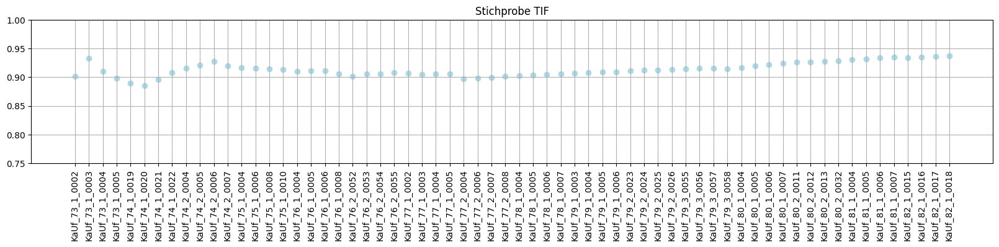

In [24]:
import matplotlib.pylab as plt

myList = average_page_dict.items()
myList = sorted(myList) 
x, y = zip(*myList) 

f = plt.figure()
f.set_figwidth(20)
f.set_figheight(3)
plt.title("Stichprobe TIF")
plt.scatter(x, y, color='lightblue')
plt.ylim(0.75, 1)

plt.xticks(rotation=90)
plt.grid(True)
plt.show()